In [1]:
import sys
print(sys.version)
print(sys.executable)

3.8.17 (default, Jul  5 2023, 21:04:15) 
[GCC 11.2.0]
/public3/home/scg6055/.conda/envs/py38/bin/python


In [2]:
import os
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
from matplotlib import rcParams
import seaborn as sns
import anndata as an
# import scanorama
from scipy.sparse import csr_matrix
from deside.single_cell import get_10x_mtx, normalize_mtx
from deside.utility import check_dir
from deside.utility import log_exp2cpm,non_log2cpm,non_log2log_cpm
sns.set()
sns.set()

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/umap/distances.py:1053: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/umap/distances.py:1061: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packag

In [3]:
result_dir = os.path.join(r'../results/3CA/Data_Sun2021_Liver-Biliary')
data_set_name = str('all_HCC_Sun_Cell_2021_merged')
check_dir(result_dir)

In [4]:
gene_name_path = r'../data/3CA/Data_Sun2021_Liver-Biliary/Genes.txt'
cell_information_path = r'../data/3CA/Data_Sun2021_Liver-Biliary/Cells.csv'
gene_name = pd.read_csv(gene_name_path,sep=',',header =None,index_col=0)
cell_information = pd.read_csv(cell_information_path,sep=',',index_col=0,header =0)
print(gene_name.shape)
print(cell_information.shape)
anno = cell_information.copy()


(19744, 0)
(16498, 6)


(16498, 19744)
13.0
214372.12003811117


(array([    0.,     0.,     0.,     0.,     0., 16498.,     0.,     0.,
            0.,     0.]),
 array([ 999999.5,  999999.6,  999999.7,  999999.8,  999999.9, 1000000. ,
        1000000.1, 1000000.2, 1000000.3, 1000000.4, 1000000.5]),
 <BarContainer object of 10 artists>)

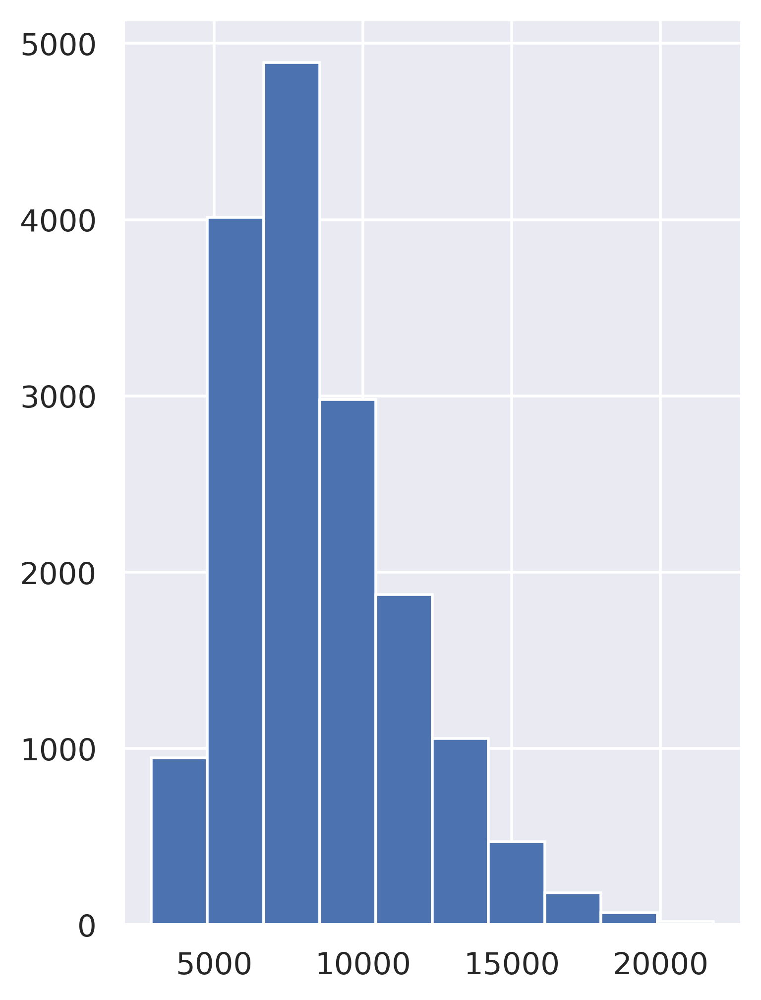

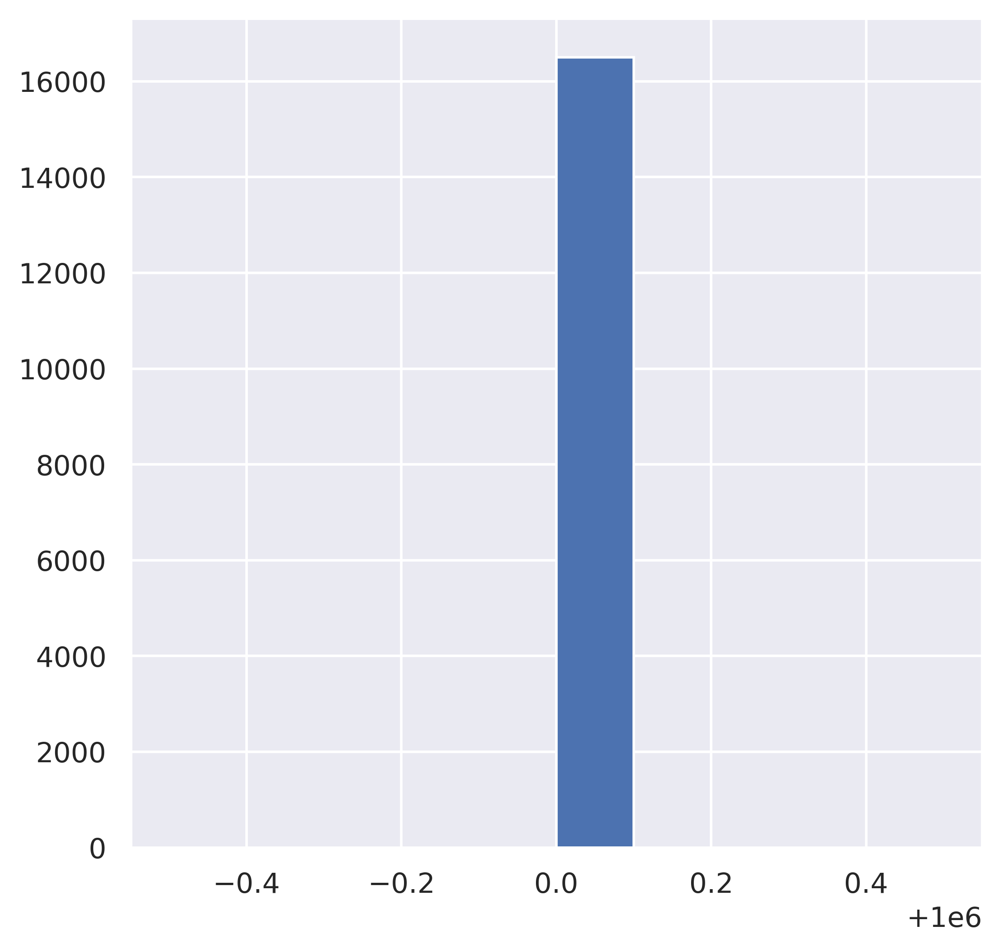

In [5]:
data_path = r'../data/3CA/Data_Sun2021_Liver-Biliary/Exp_data_TPM.mtx'
all_dataset = sc.read(data_path)
all_dataset = all_dataset.T
print(all_dataset.shape)   #(16498, 19744)
data = all_dataset.X
data = pd.DataFrame( data.todense())  
plt.figure(figsize=(4,6))
print(data.max().max())
ax = plt.hist(data.sum(axis=1))
data = log_exp2cpm(exp_df=data, log_base=2, correct=1)
print(data.max().max())
plt.figure(figsize=(6,6))
plt.hist(np.around(np.array(data.sum(axis=1)),0))



#16498 sample


In [6]:
all_dataset = an.AnnData(data)
all_dataset.X = csr_matrix(all_dataset.X)
all_dataset

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


AnnData object with n_obs × n_vars = 16498 × 19744

In [7]:
all_dataset.var.index = gene_name.index
all_dataset.obs = cell_information
all_dataset.obs = all_dataset.obs.rename(columns ={'sample':'sample_id'})
all_dataset

AnnData object with n_obs × n_vars = 16498 × 19744
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity'

In [8]:
for col in all_dataset.obs.columns:
    all_dataset.obs[col] = all_dataset.obs[col].astype(str)

all_dataset.obs.dtypes

sample_id                object
source                   object
disease                  object
cell_type                object
cell_subtype_clusters    object
complexity               object
dtype: object

In [9]:
all_dataset.var.index.name = 'gene_name'

In [10]:
all_dataset.var

""
gene_name
OR4F5
FO538757.2
FO538757.1
OR4F29
OR4F16
...
AC004556.1
AC233755.2
AC233755.1


In [11]:
all_dataset = all_dataset[all_dataset.obs.source=='Tumor',:]
print(all_dataset.shape)
all_dataset.obs

(14236, 19744)


,sample_id,source,disease,cell_type,cell_subtype_clusters,complexity
cell_name,,,,,,
P01_T_0001,P01,Tumor,Relapsed_HCC,Malignant,C10_Tumor,8444
P01_T_0003,P01,Tumor,Relapsed_HCC,Malignant,C10_Tumor,6481
P01_T_0004,P01,Tumor,Relapsed_HCC,NK_cell,C4_NK,7517
P01_T_0007,P01,Tumor,Relapsed_HCC,Malignant,C10_Tumor,6625
P01_T_0008,P01,Tumor,Relapsed_HCC,Endothelial,C17_Endo.,7891
...,...,...,...,...,...,...
P19_T_0138,P19,Tumor,Primary_HCC,T_cell,C1_Tcell,8611
P19_T_0139,P19,Tumor,Primary_HCC,Malignant,C14_Tumor,8255
P19_T_0143,P19,Tumor,Primary_HCC,Malignant,C14_Tumor,9421


In [12]:
all_dataset

View of AnnData object with n_obs × n_vars = 14236 × 19744
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity'

In [13]:
all_files = list(all_dataset.obs['sample_id'].unique())
print(len(all_files))
print(all_dataset.obs['sample_id'].value_counts())


18
P09    1464
P10    1446
P08    1436
P16    1313
P11    1203
P03    1200
P18    1082
P15    1037
P02     898
P05     629
P04     561
P13     476
P12     430
P14     418
P07     281
P17     135
P01     119
P19     108
Name: sample_id, dtype: int64


#----------------------------------------------
Deal with P01...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (119, 19744)


<Figure size 3000x600 with 0 Axes>

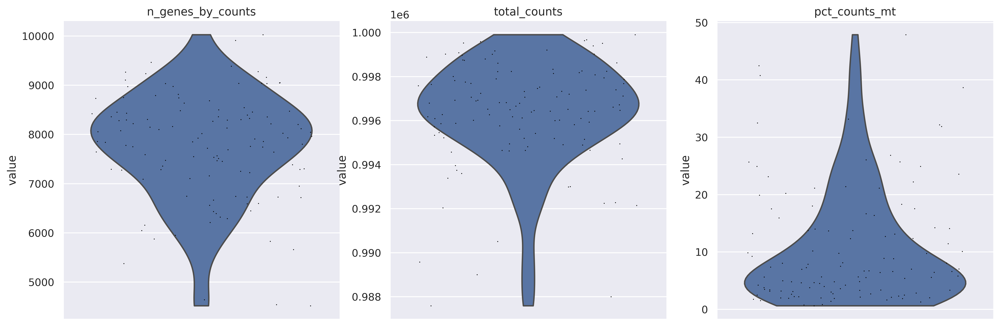

<Figure size 1600x1200 with 0 Axes>

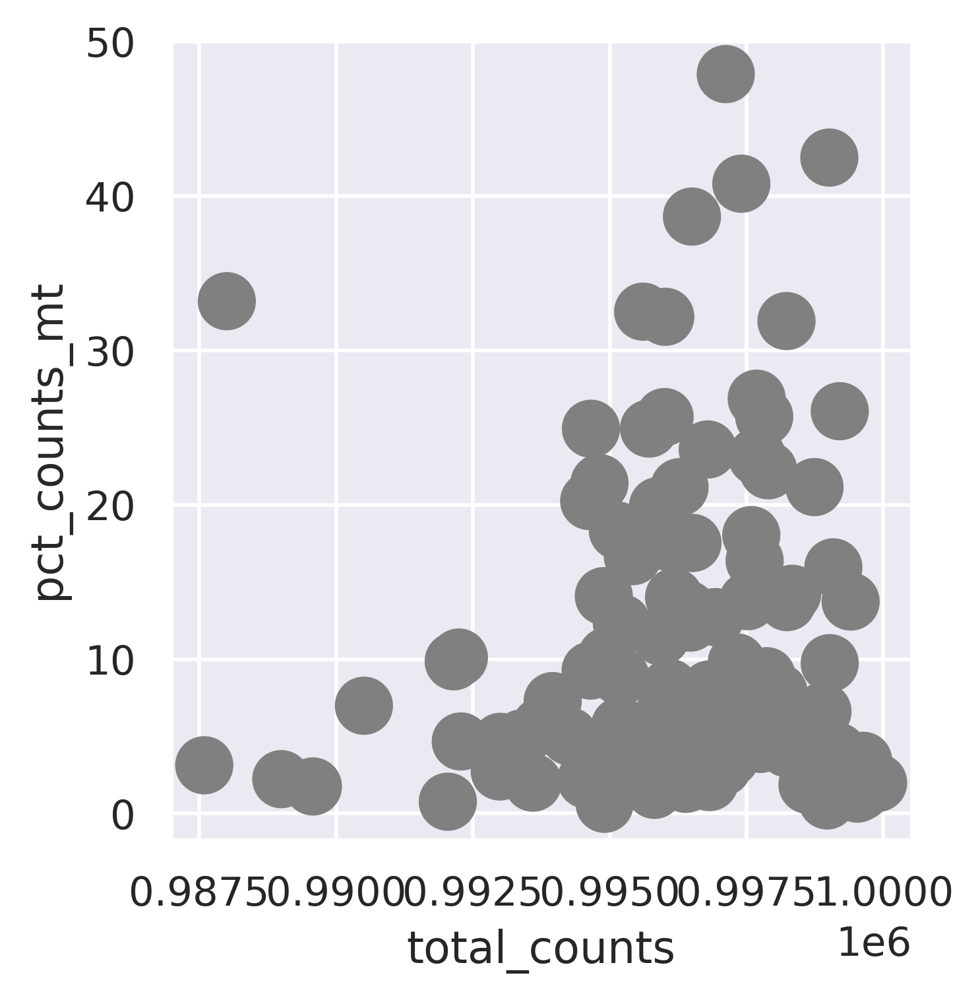

<Figure size 1600x1200 with 0 Axes>

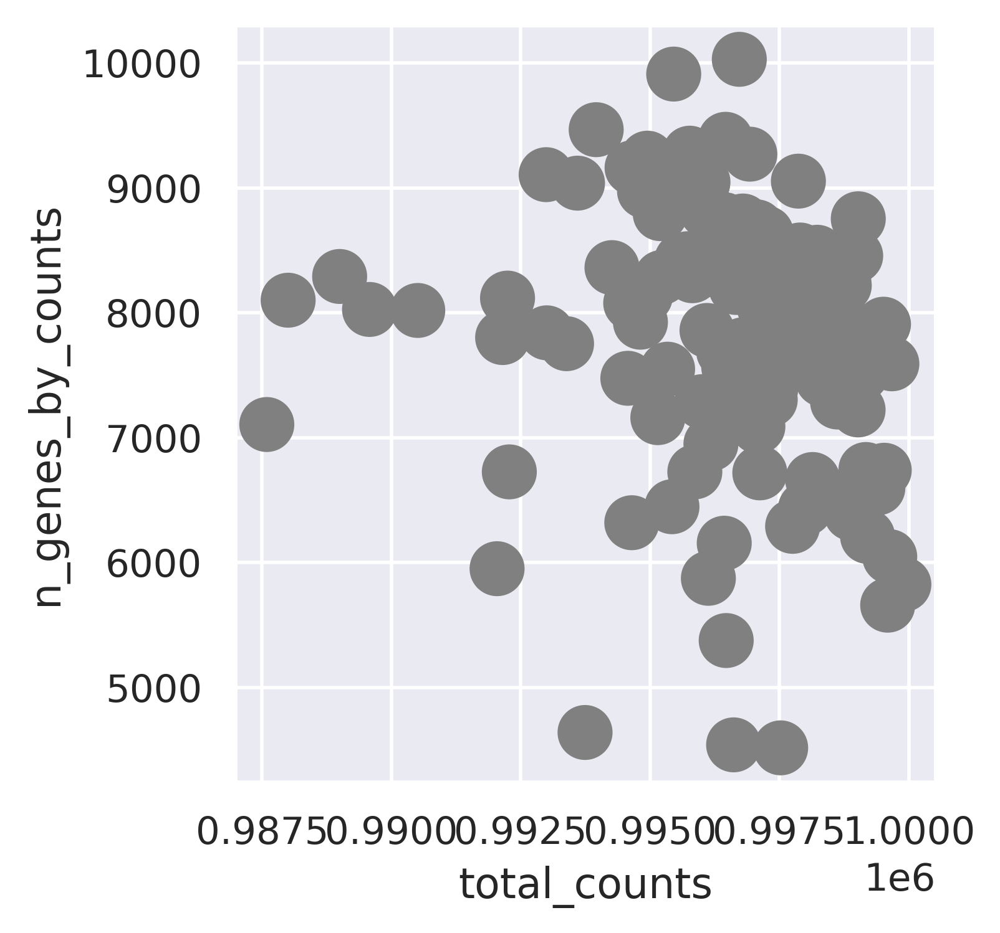

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (75, 13246)
#----------------------------------------------
Deal with P02...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (898, 19744)


<Figure size 3000x600 with 0 Axes>

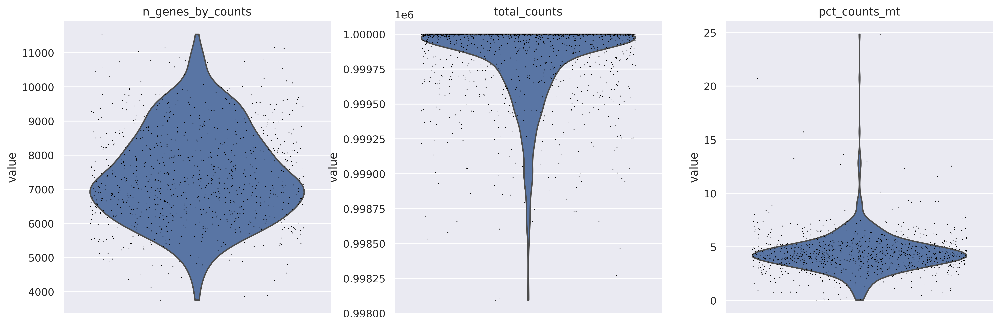

<Figure size 1600x1200 with 0 Axes>

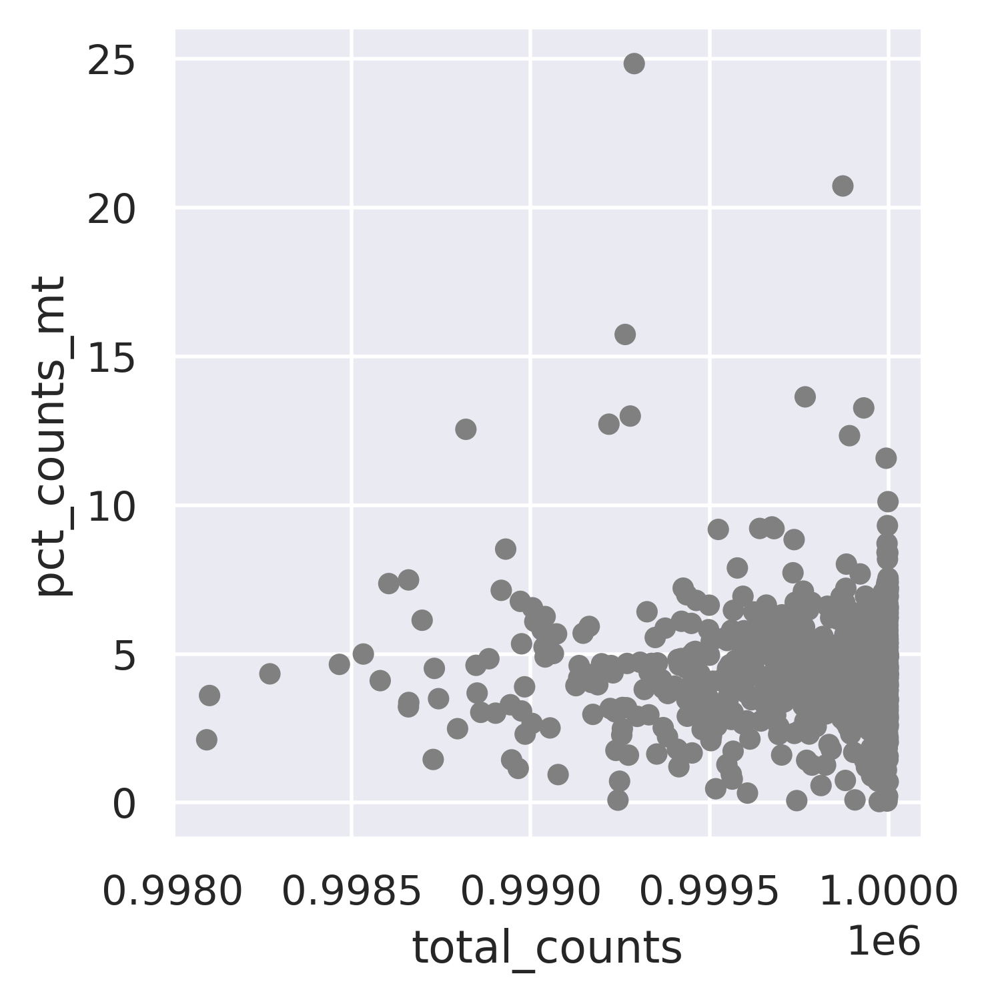

<Figure size 1600x1200 with 0 Axes>

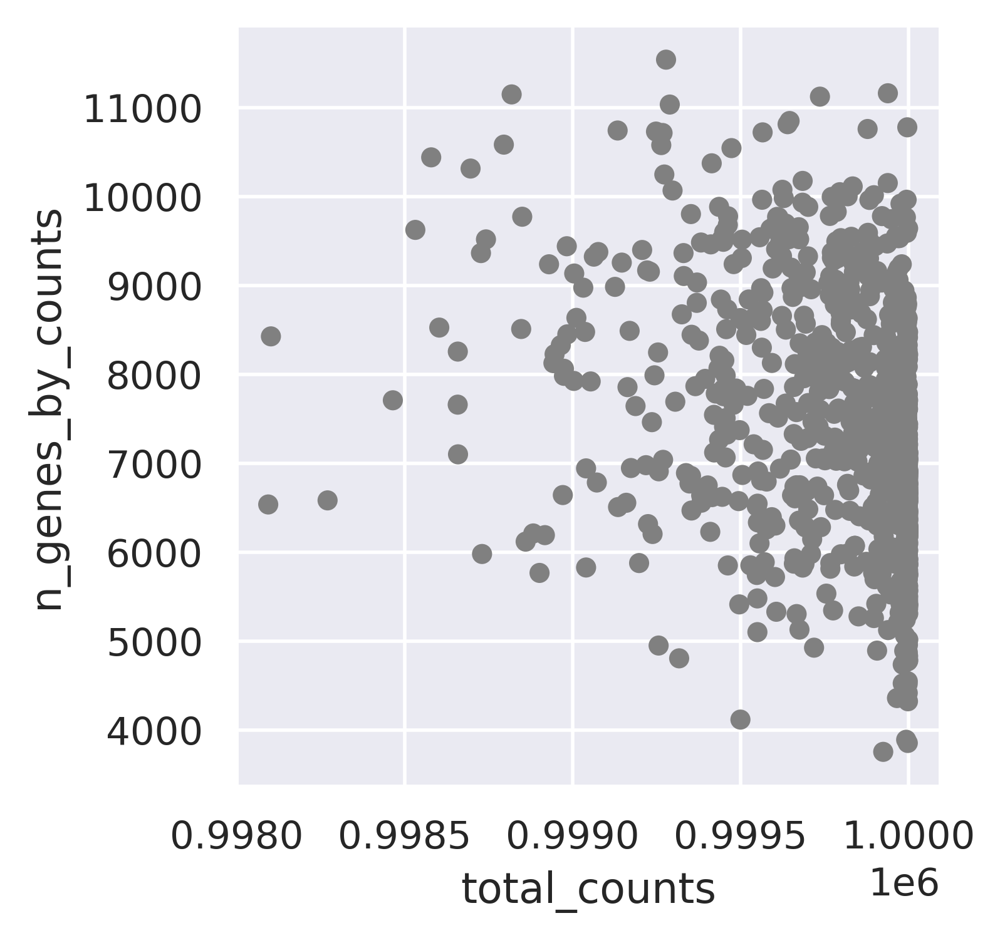

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (863, 15689)
#----------------------------------------------
Deal with P03...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1200, 19744)


<Figure size 3000x600 with 0 Axes>

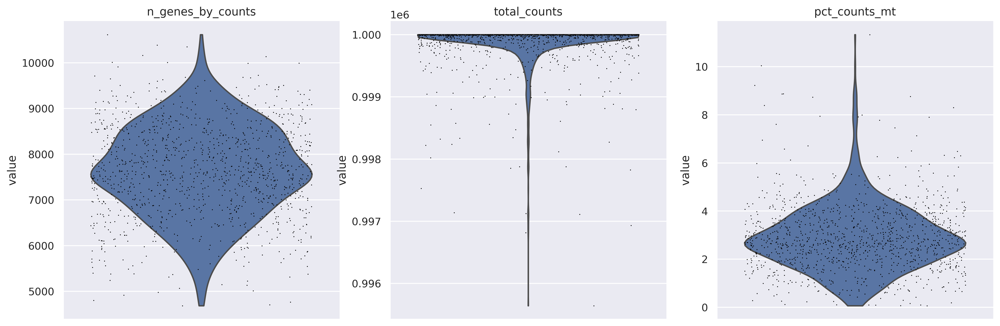

<Figure size 1600x1200 with 0 Axes>

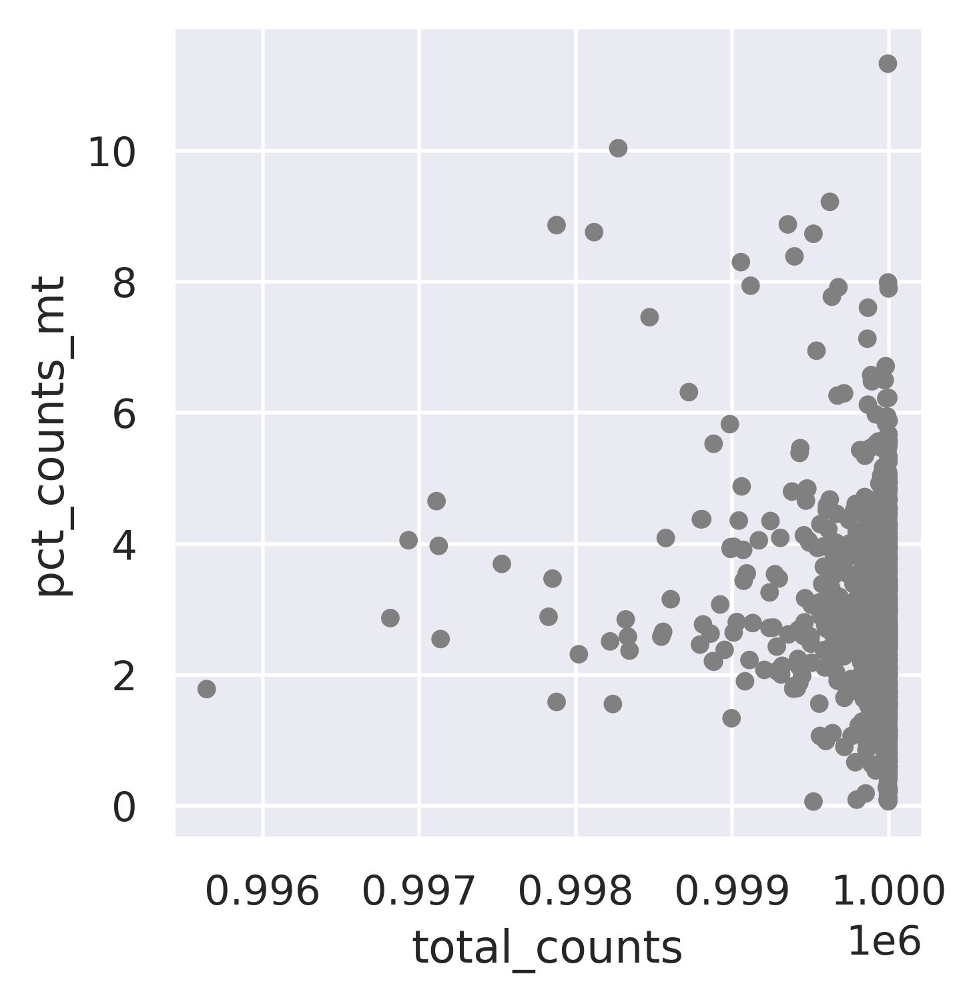

<Figure size 1600x1200 with 0 Axes>

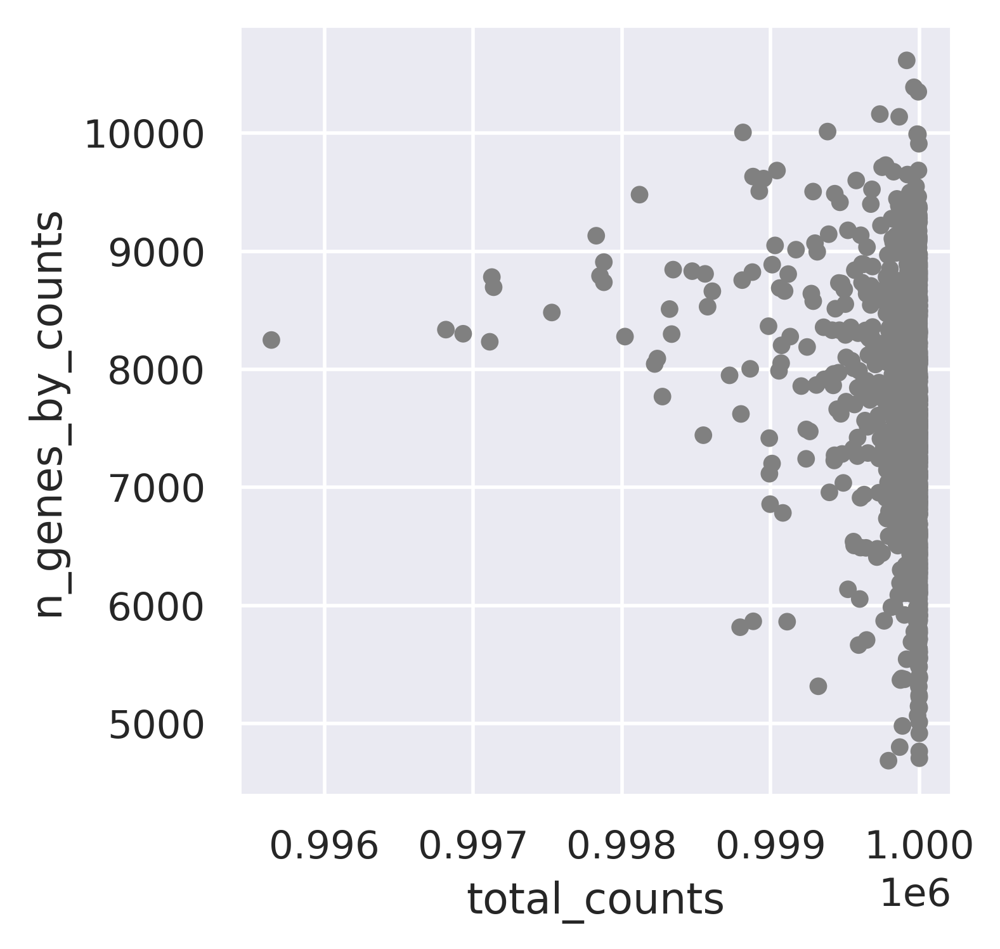

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1191, 15559)
#----------------------------------------------
Deal with P04...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (561, 19744)


<Figure size 3000x600 with 0 Axes>

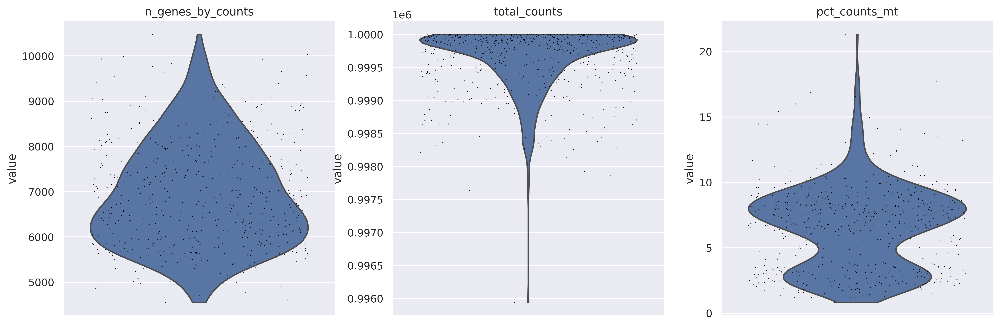

<Figure size 1600x1200 with 0 Axes>

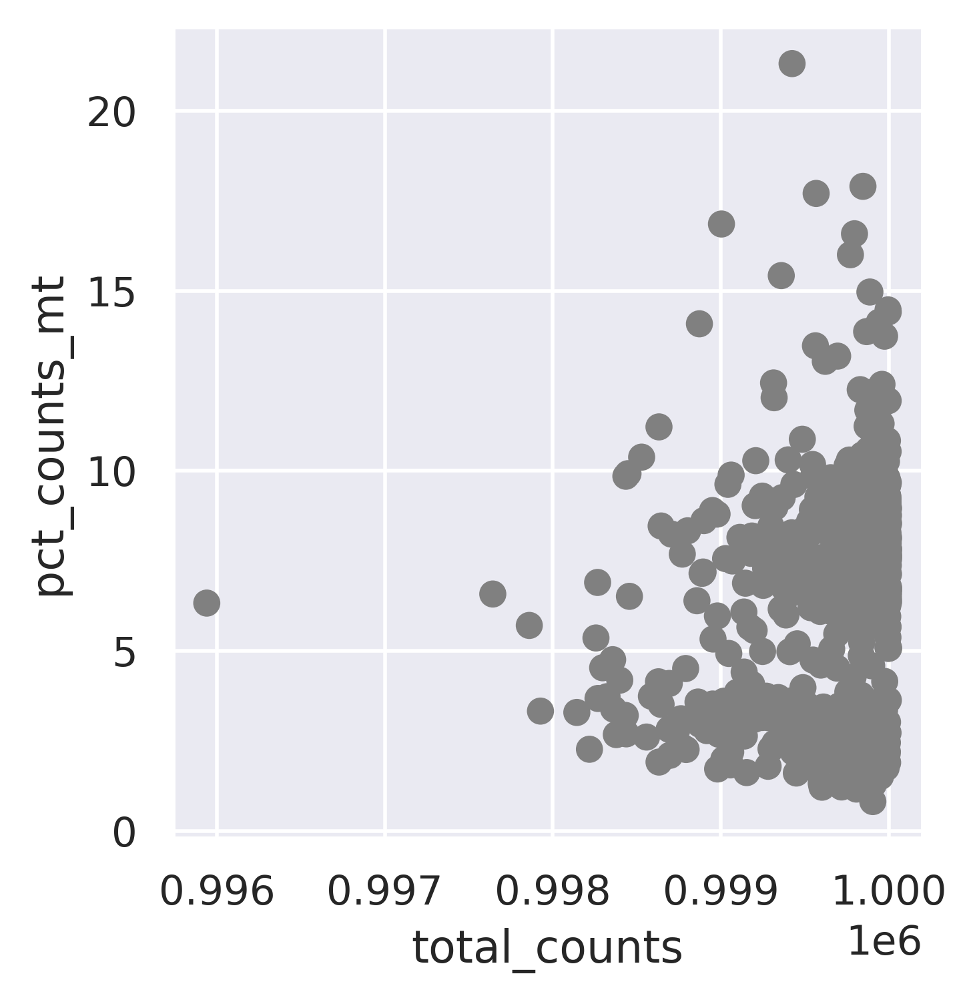

<Figure size 1600x1200 with 0 Axes>

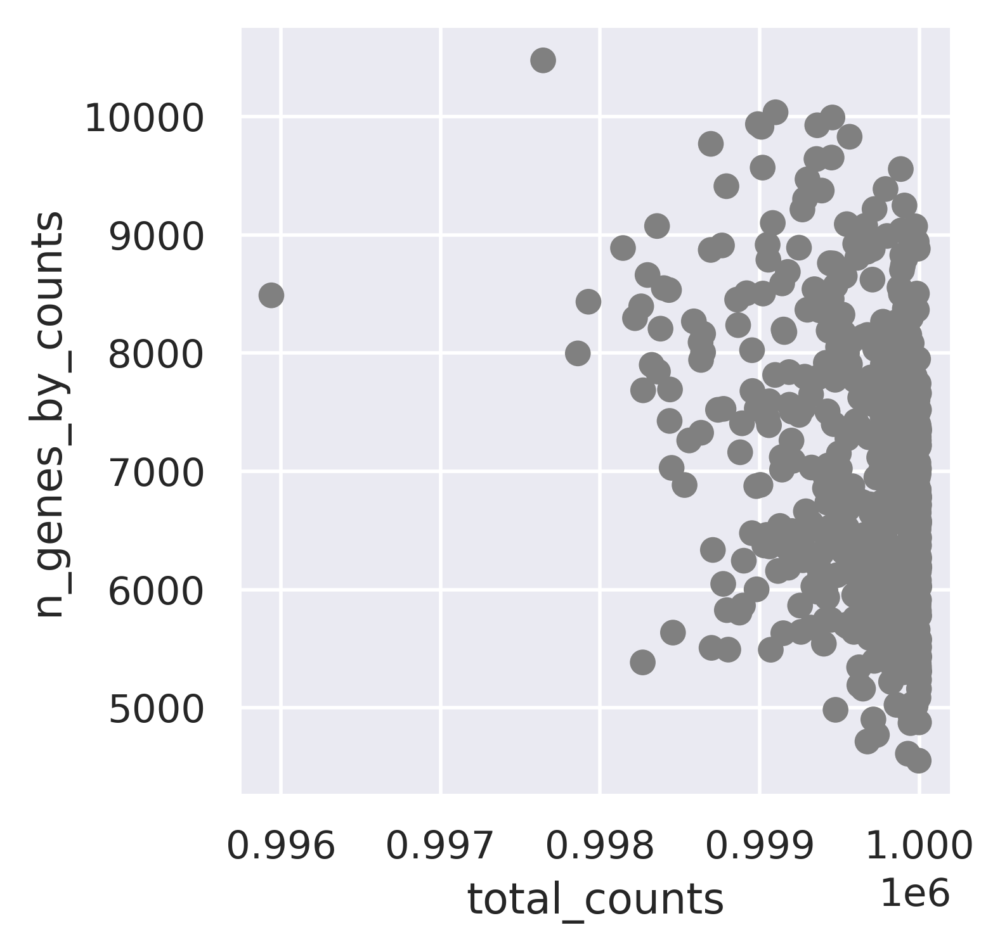

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (510, 15066)
#----------------------------------------------
Deal with P05...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (629, 19744)


<Figure size 3000x600 with 0 Axes>

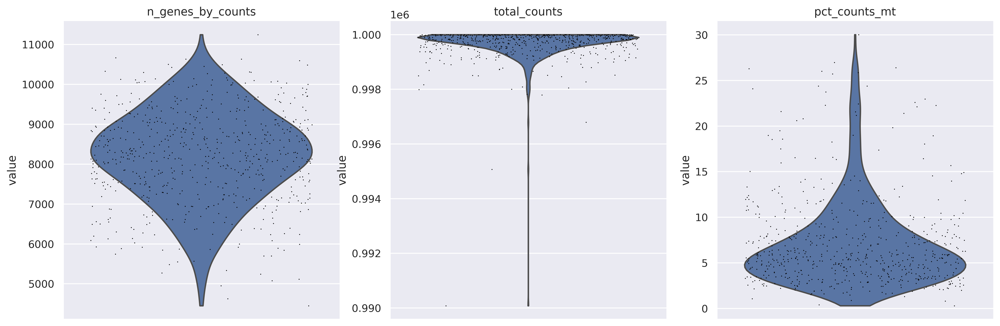

<Figure size 1600x1200 with 0 Axes>

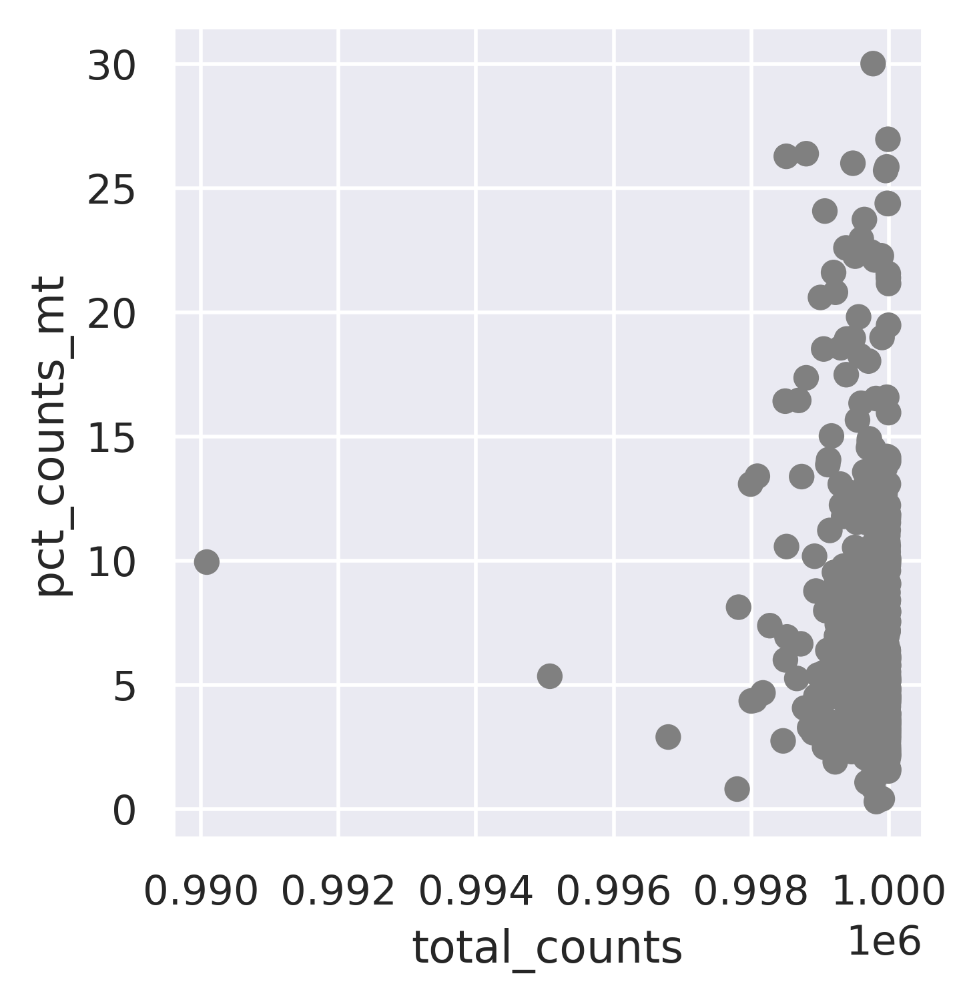

<Figure size 1600x1200 with 0 Axes>

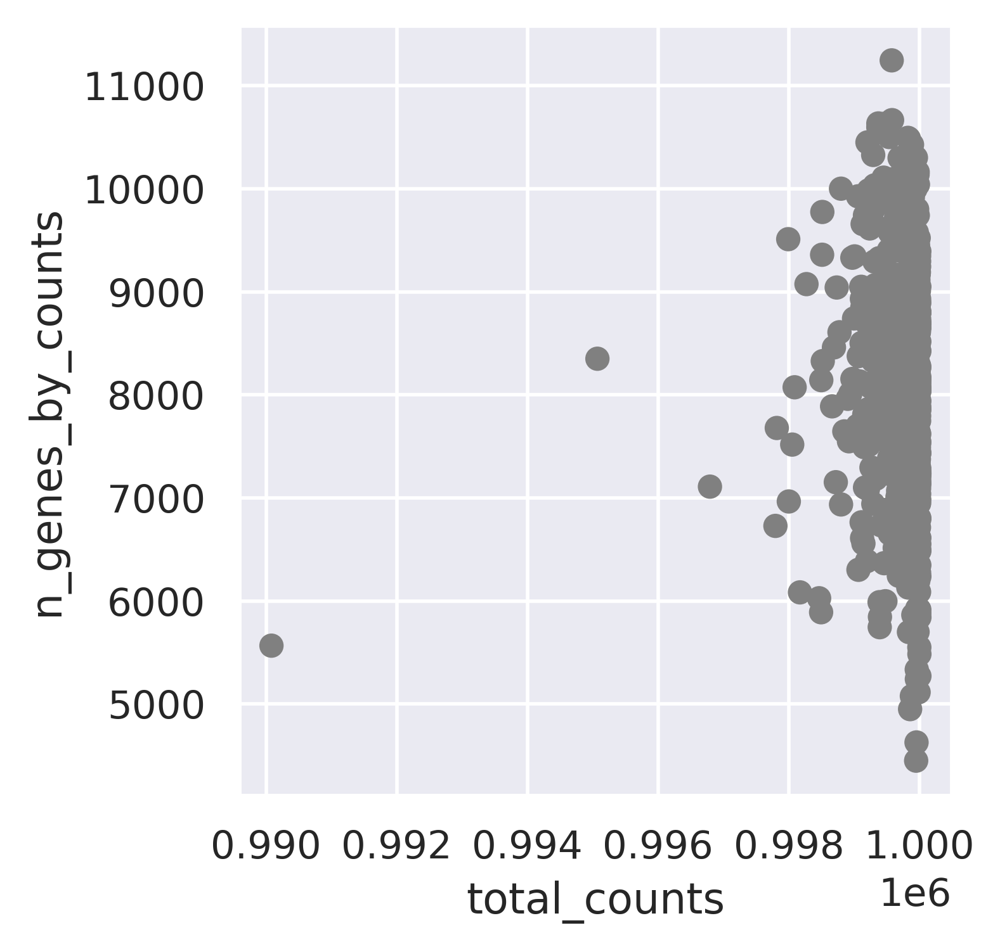

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (486, 15414)
#----------------------------------------------
Deal with P07...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (281, 19744)


<Figure size 3000x600 with 0 Axes>

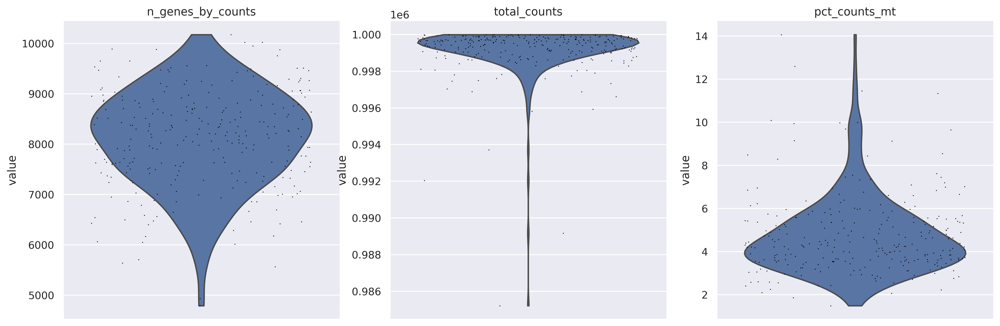

<Figure size 1600x1200 with 0 Axes>

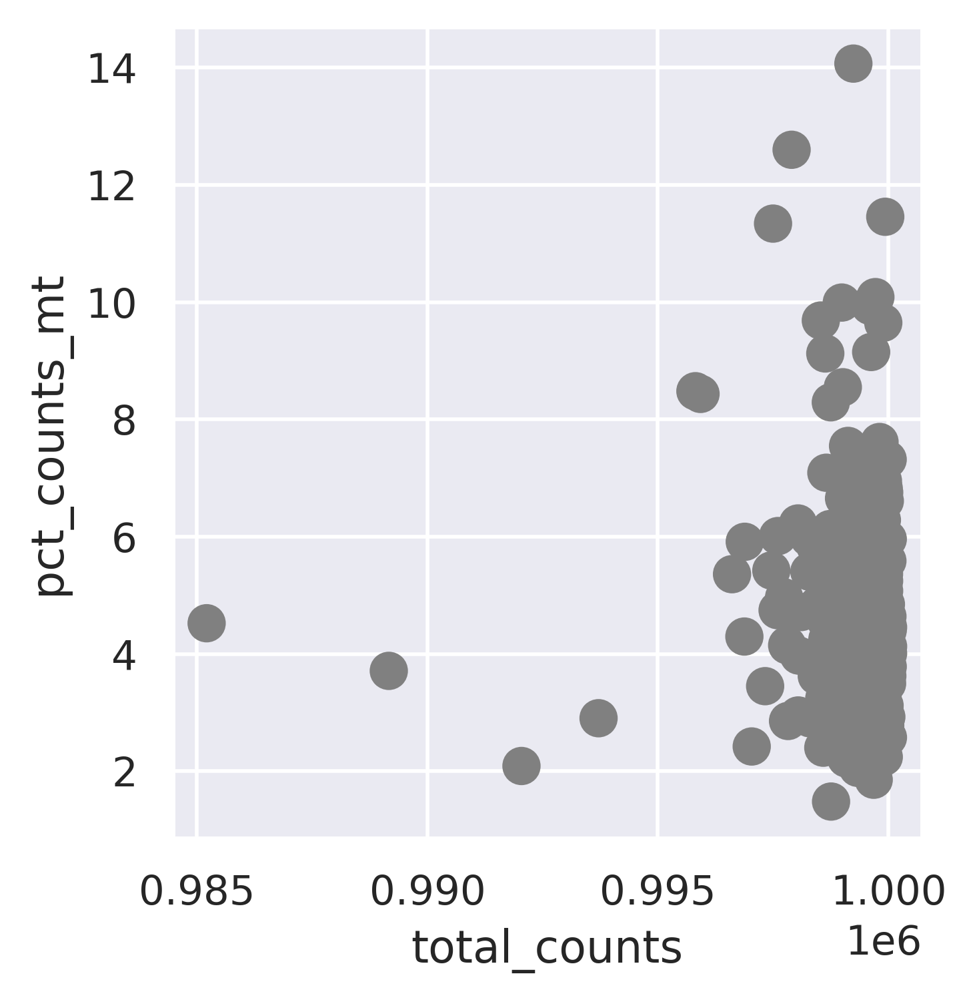

<Figure size 1600x1200 with 0 Axes>

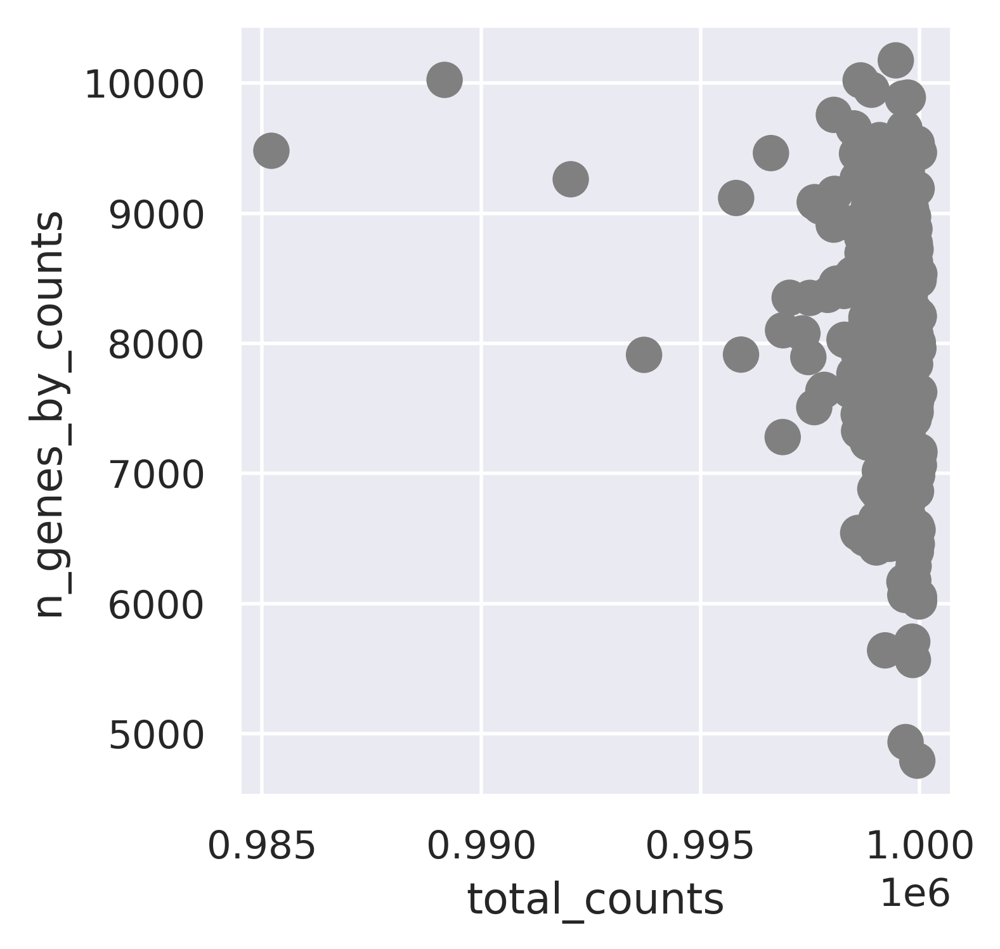

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (273, 14035)
#----------------------------------------------
Deal with P08...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1436, 19744)


<Figure size 3000x600 with 0 Axes>

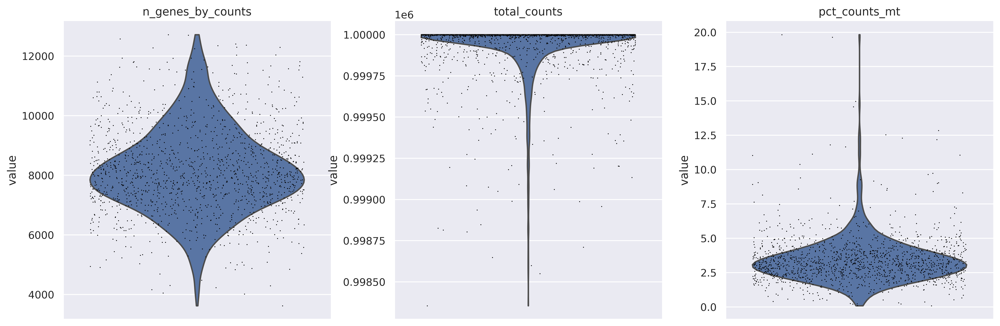

<Figure size 1600x1200 with 0 Axes>

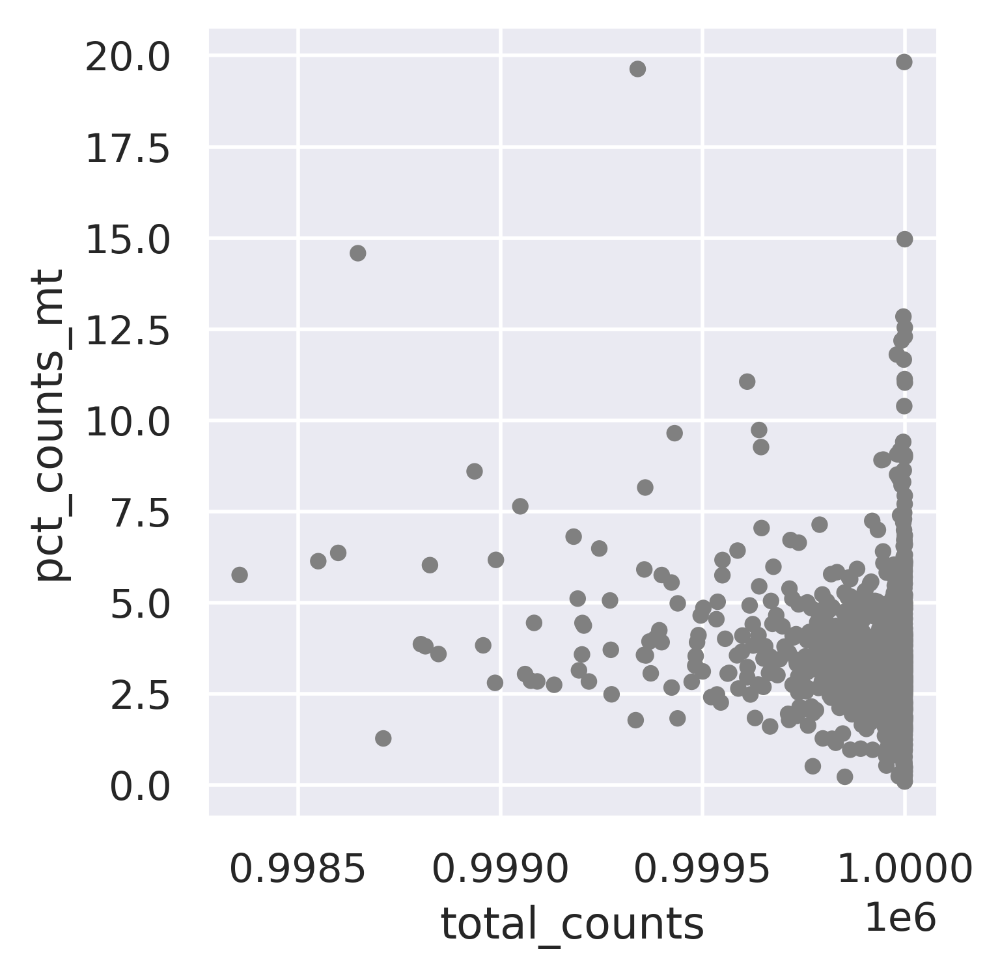

<Figure size 1600x1200 with 0 Axes>

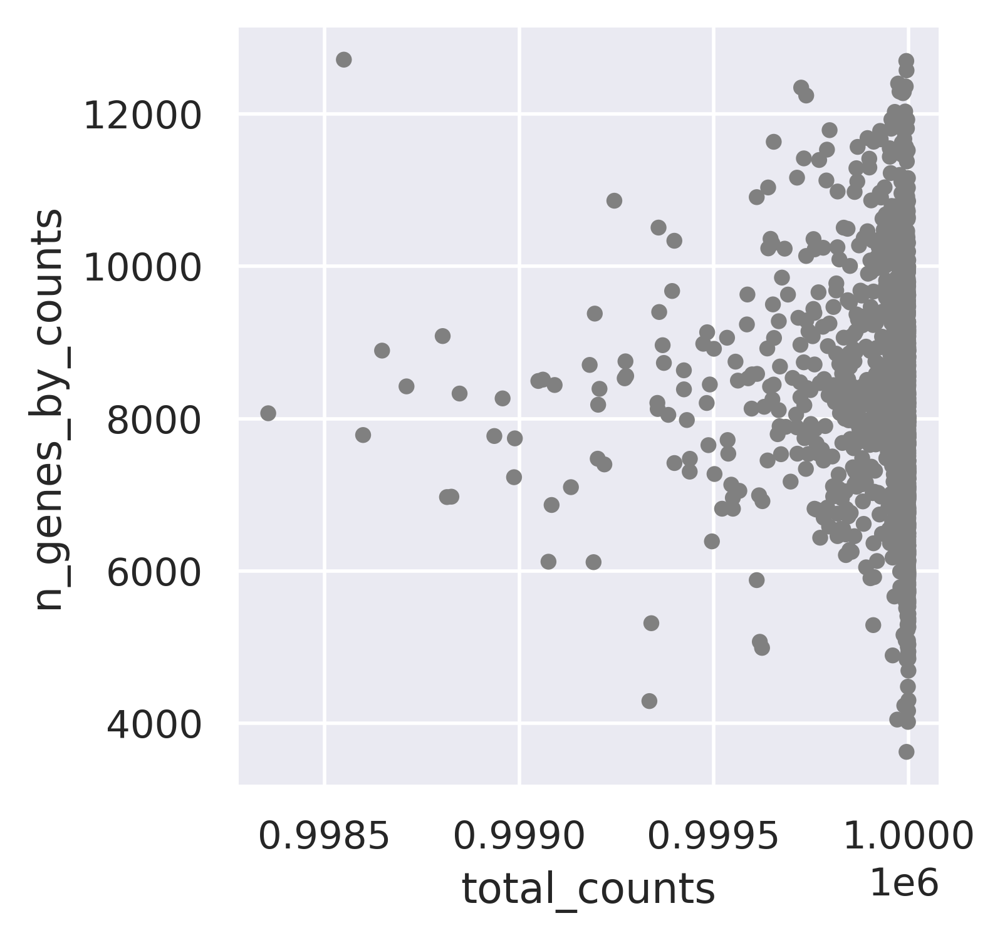

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1275, 16275)
#----------------------------------------------
Deal with P09...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1464, 19744)


<Figure size 3000x600 with 0 Axes>

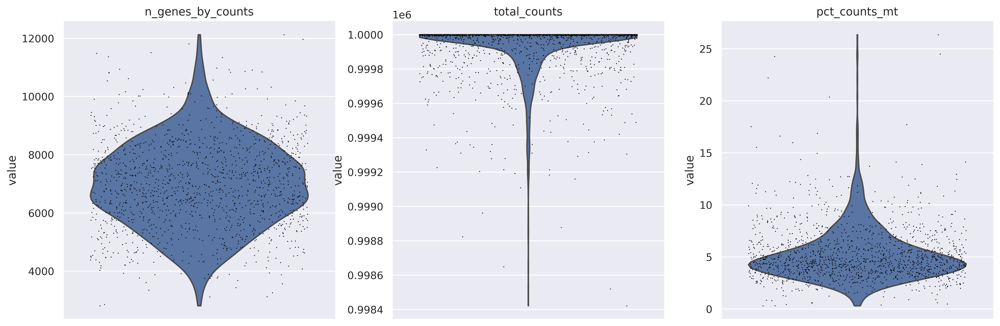

<Figure size 1600x1200 with 0 Axes>

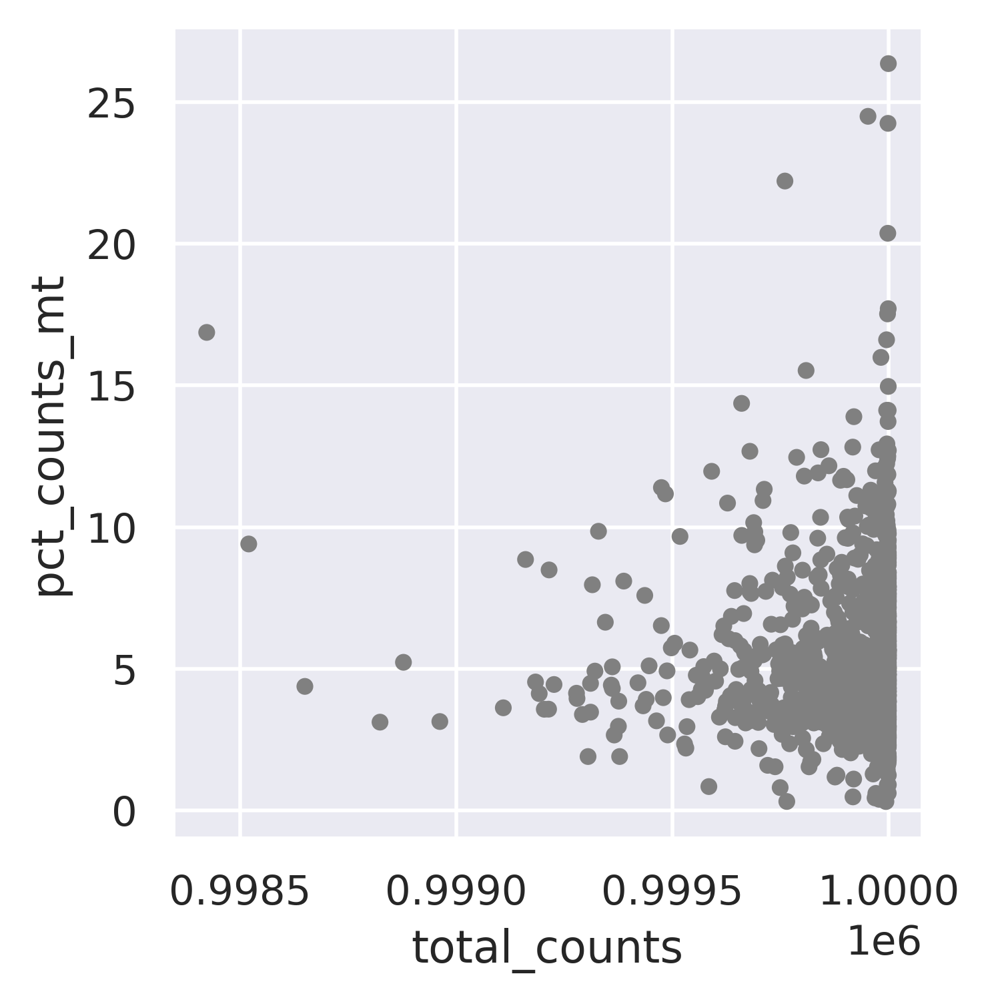

<Figure size 1600x1200 with 0 Axes>

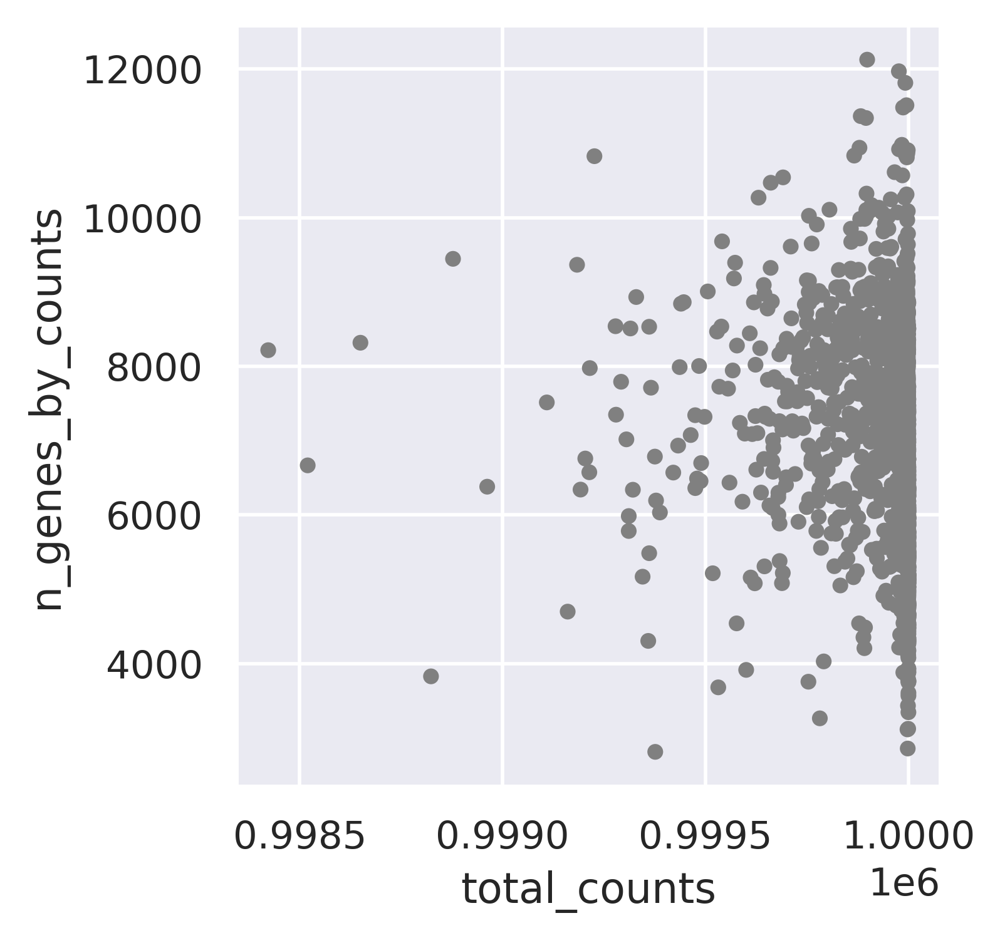

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1363, 15806)
#----------------------------------------------
Deal with P10...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1446, 19744)


<Figure size 3000x600 with 0 Axes>

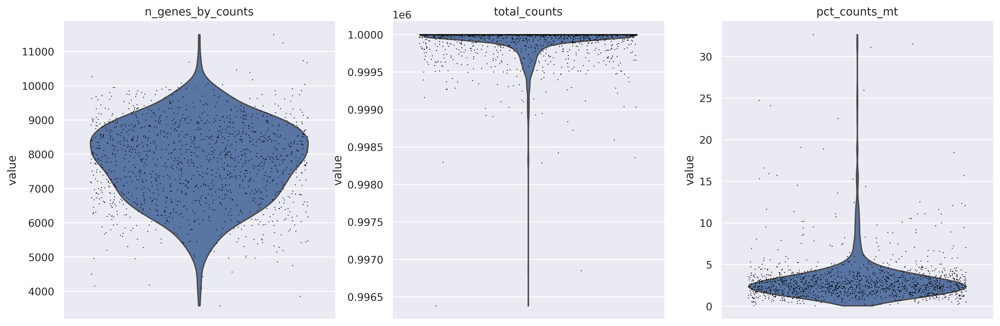

<Figure size 1600x1200 with 0 Axes>

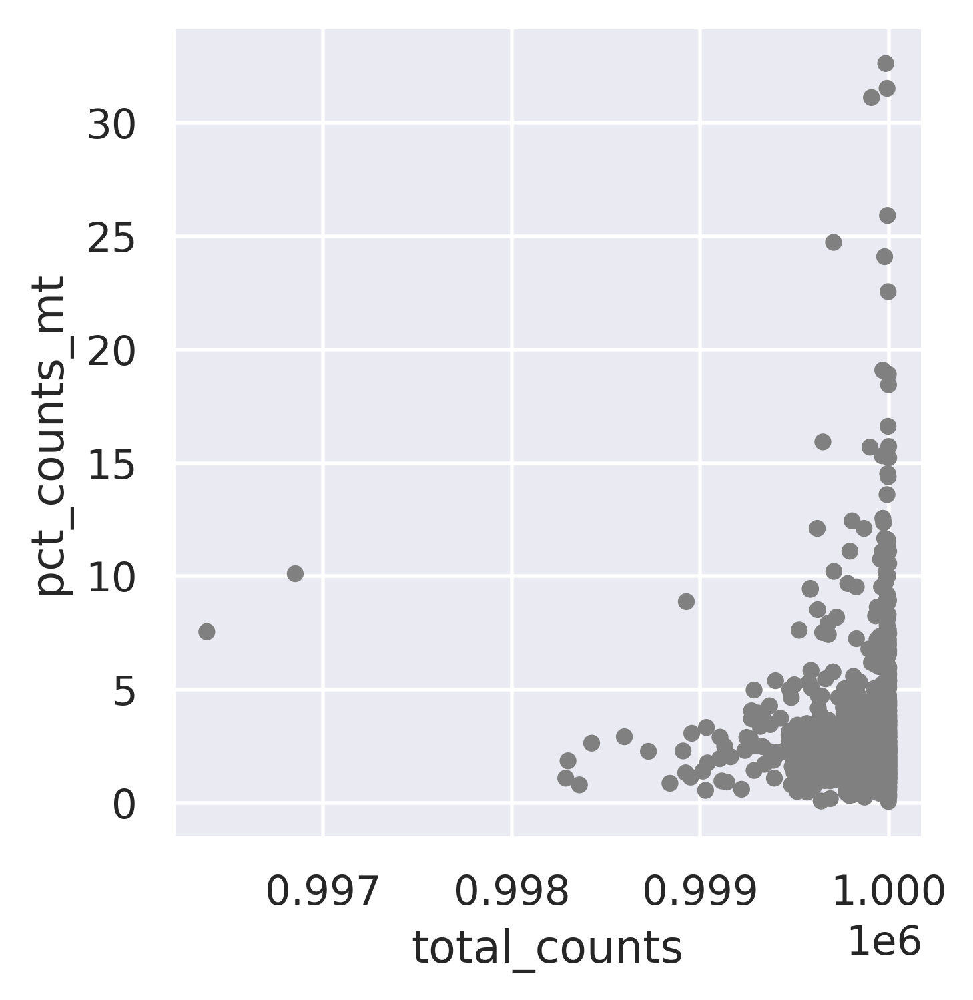

<Figure size 1600x1200 with 0 Axes>

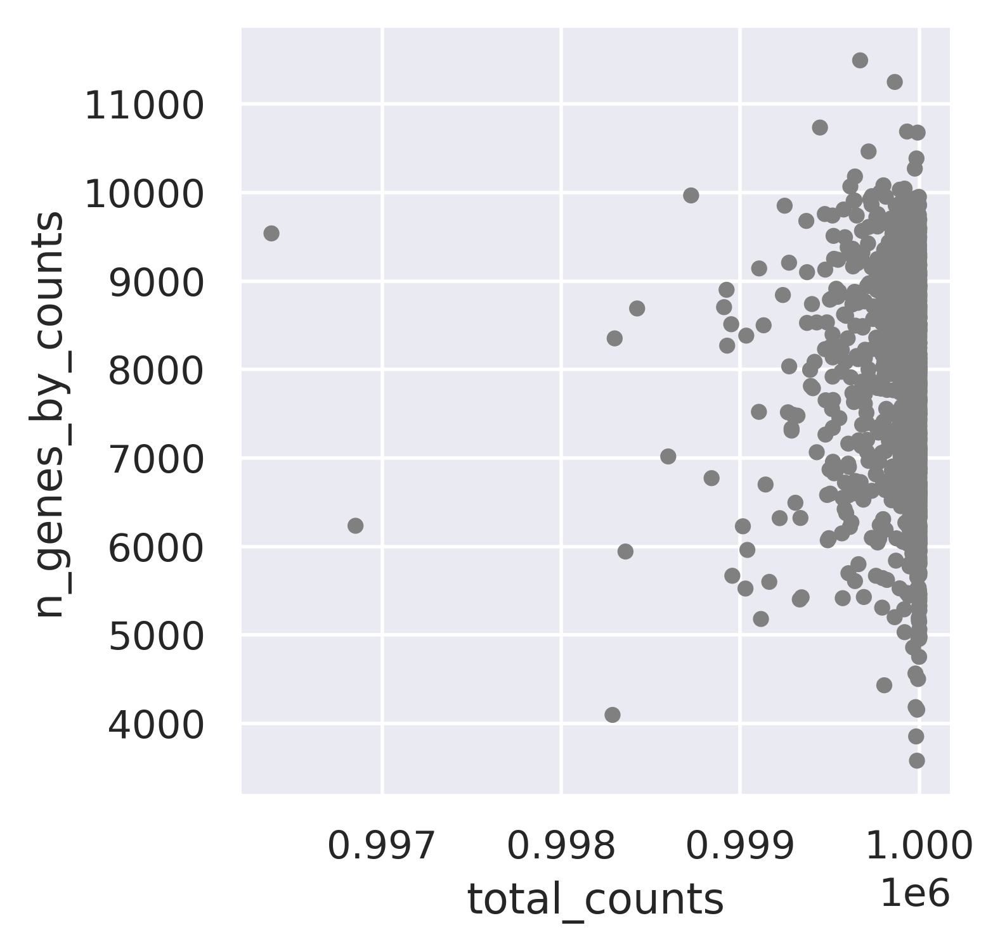

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1395, 15800)
#----------------------------------------------
Deal with P11...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1203, 19744)


<Figure size 3000x600 with 0 Axes>

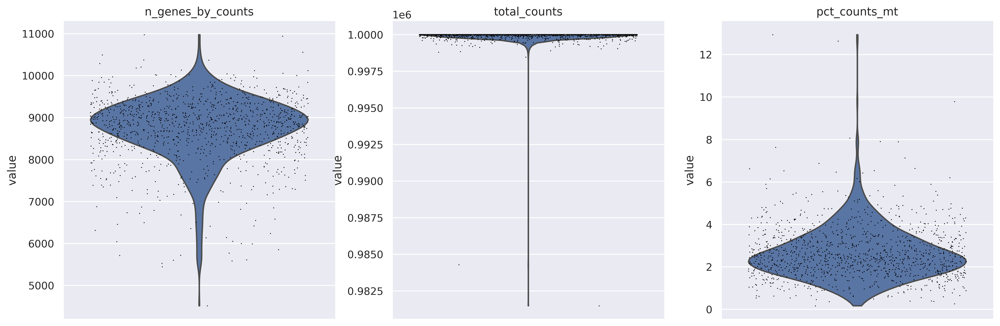

<Figure size 1600x1200 with 0 Axes>

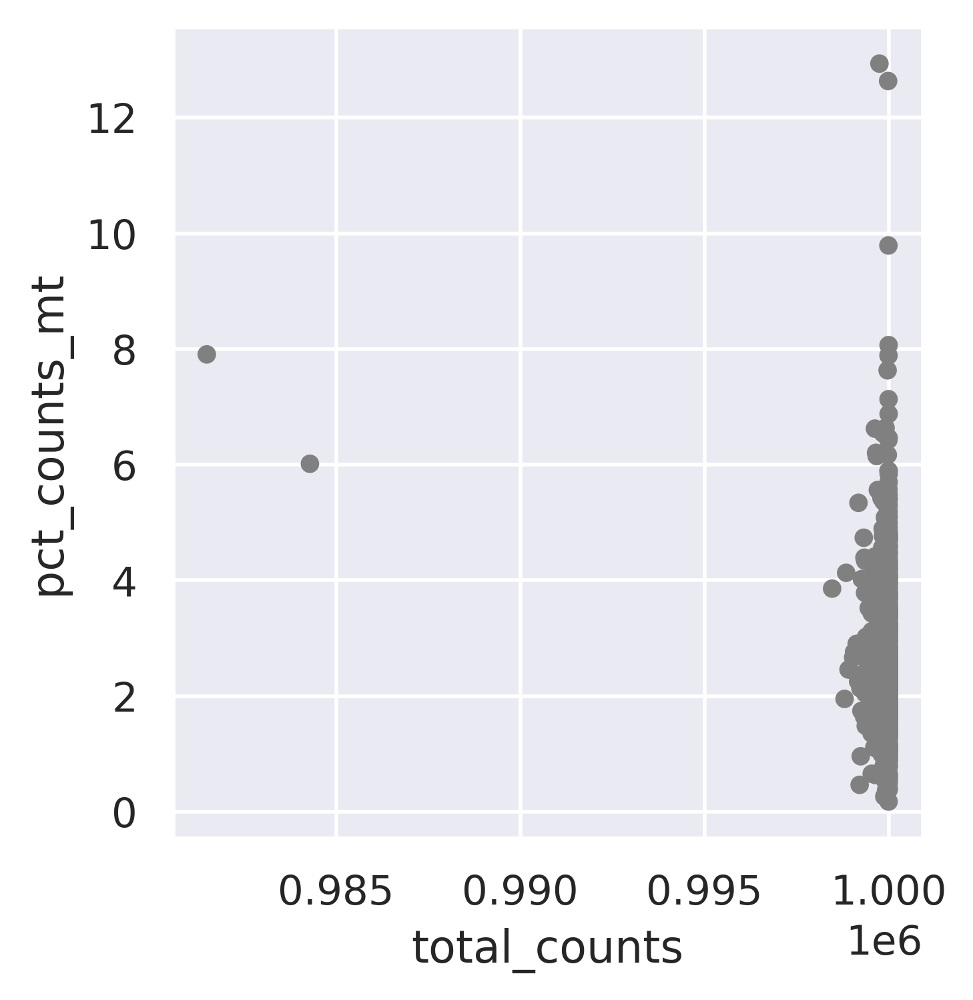

<Figure size 1600x1200 with 0 Axes>

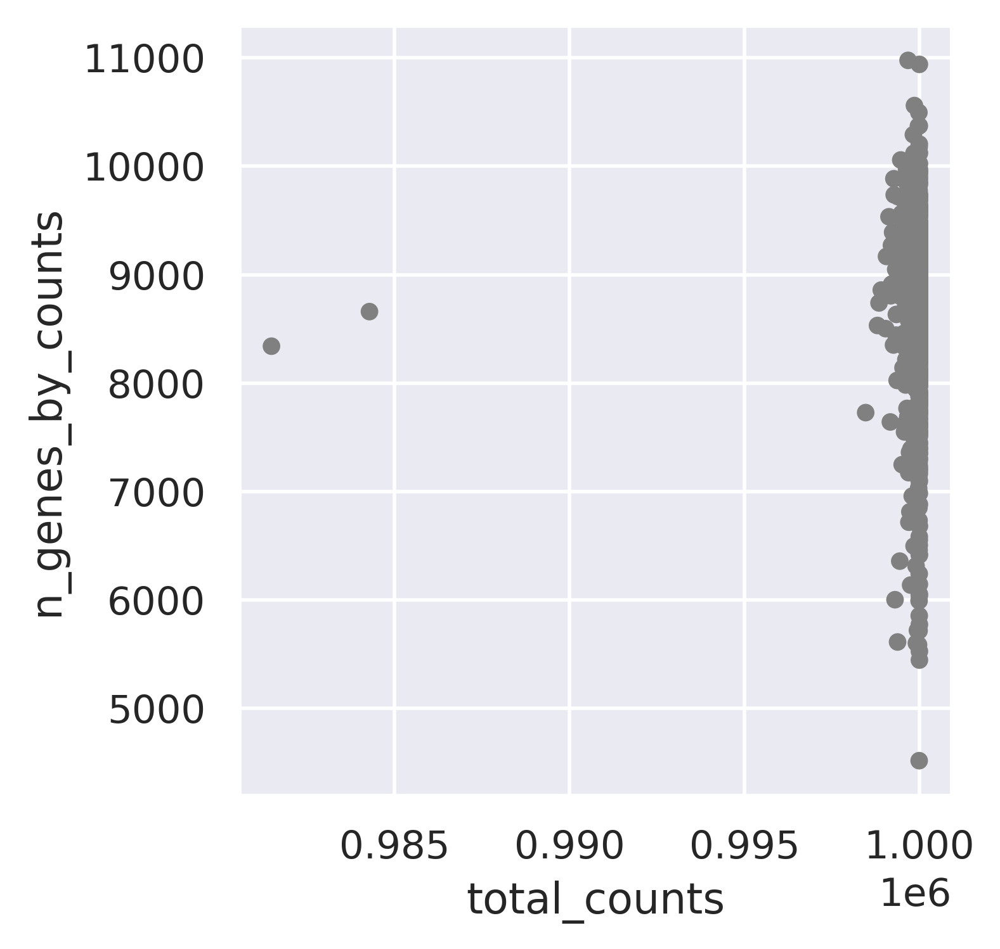

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1181, 15229)
#----------------------------------------------
Deal with P12...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (430, 19744)


<Figure size 3000x600 with 0 Axes>

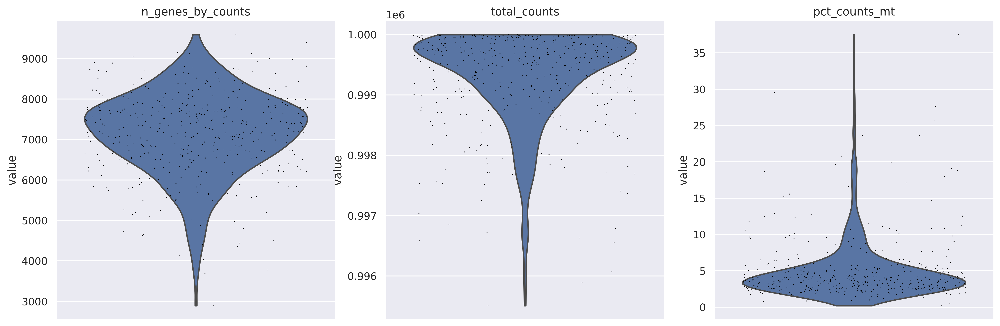

<Figure size 1600x1200 with 0 Axes>

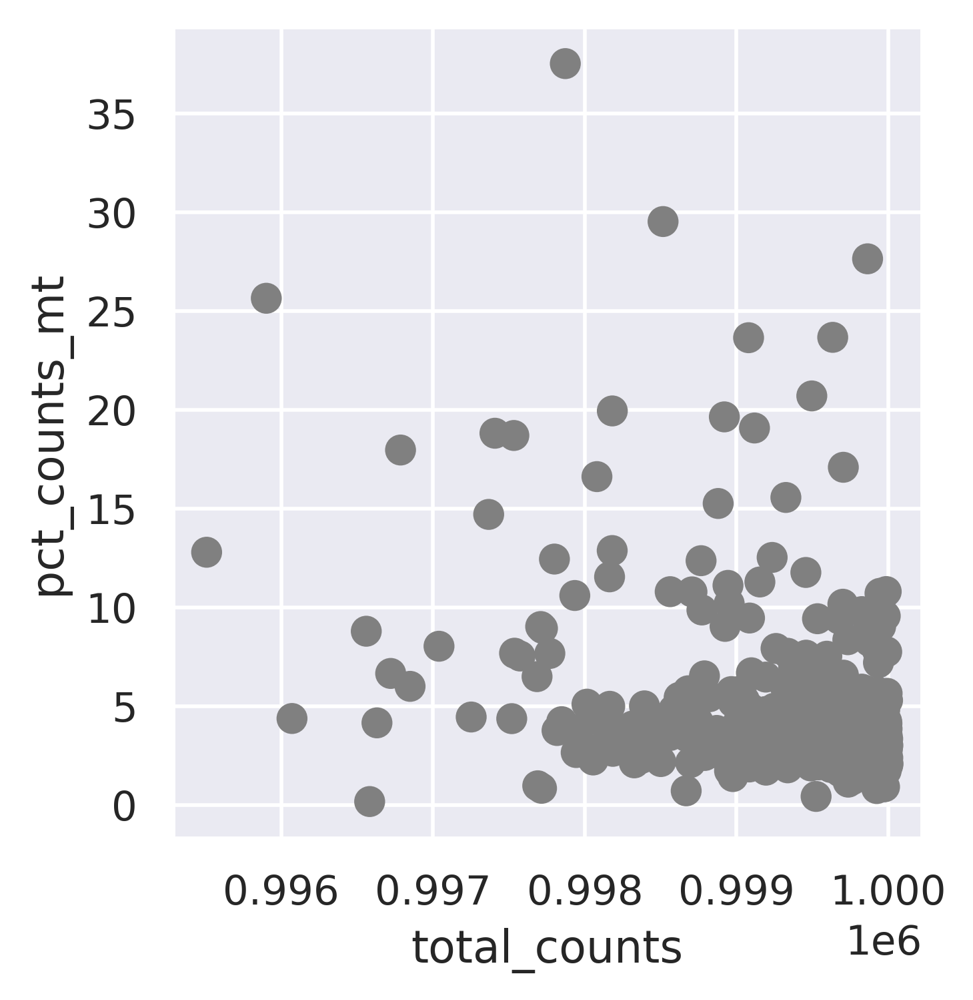

<Figure size 1600x1200 with 0 Axes>

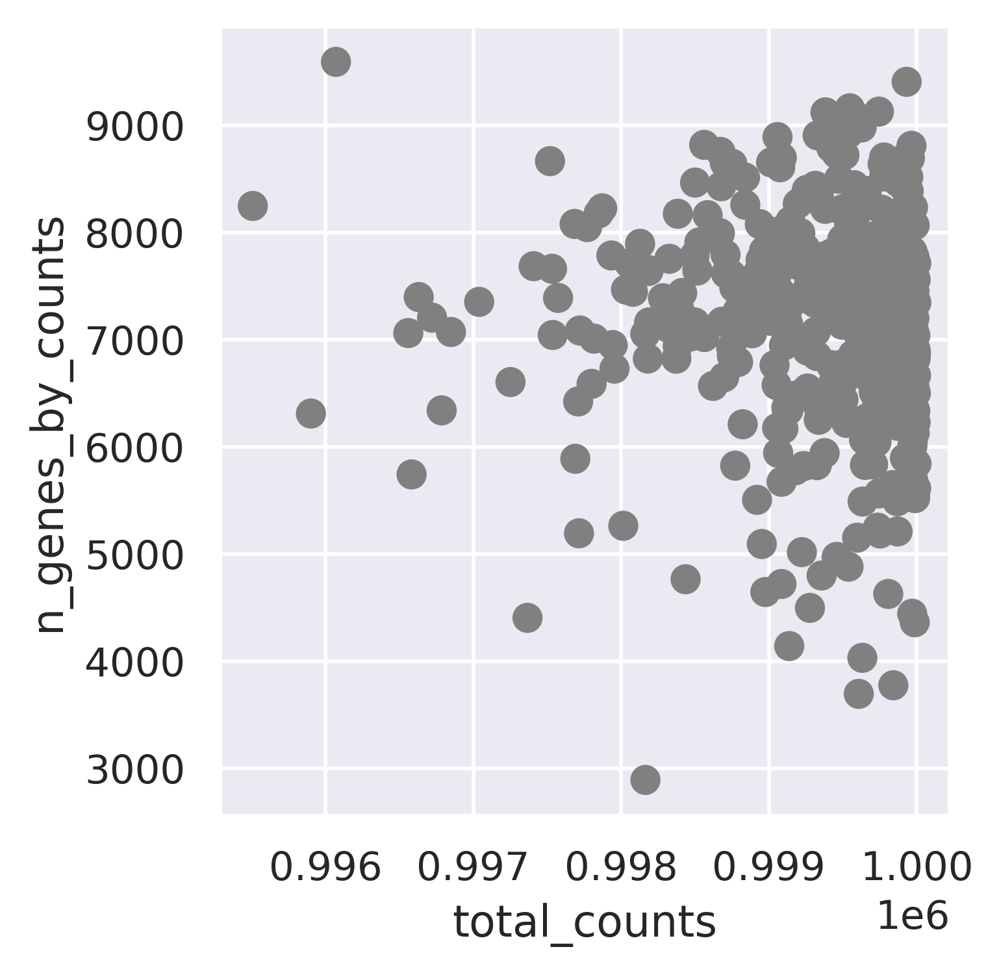

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (395, 14341)
#----------------------------------------------
Deal with P13...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (476, 19744)


<Figure size 3000x600 with 0 Axes>

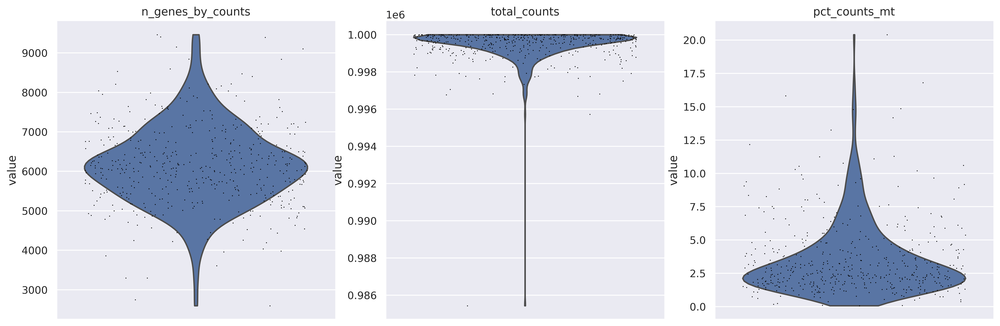

<Figure size 1600x1200 with 0 Axes>

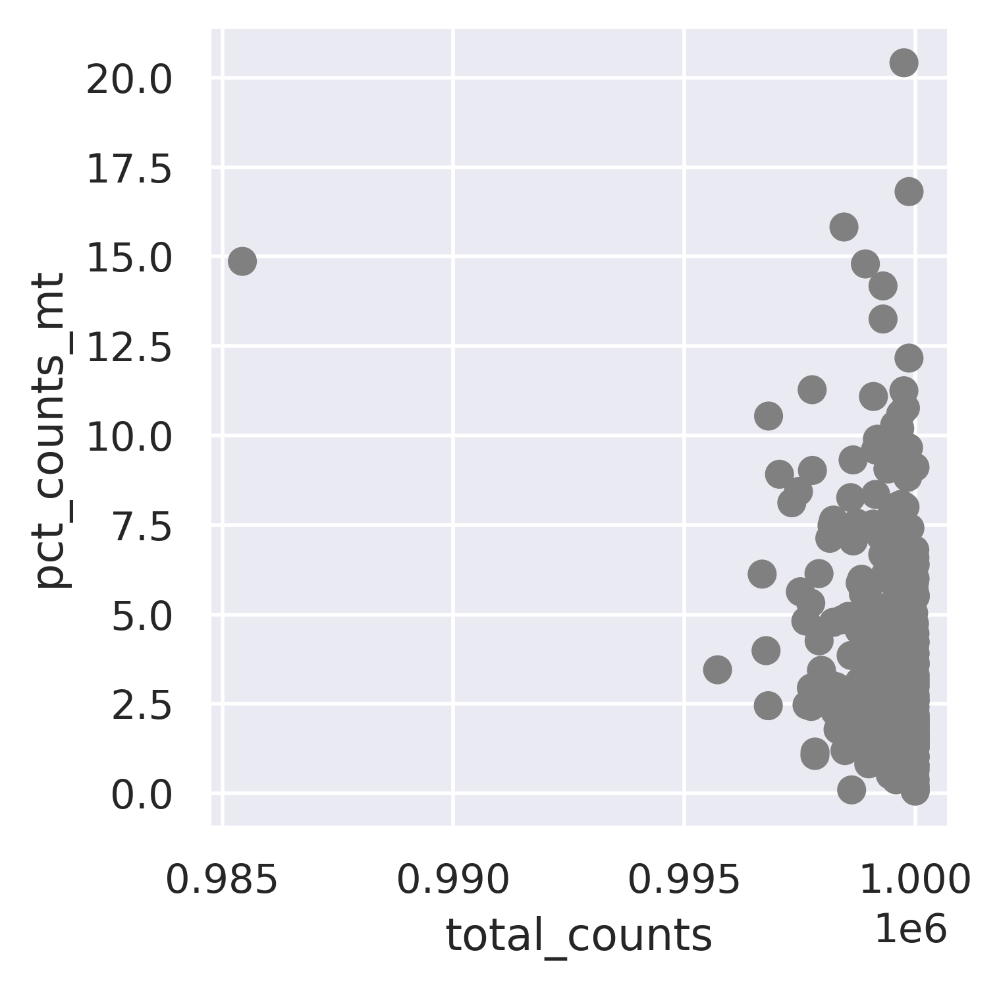

<Figure size 1600x1200 with 0 Axes>

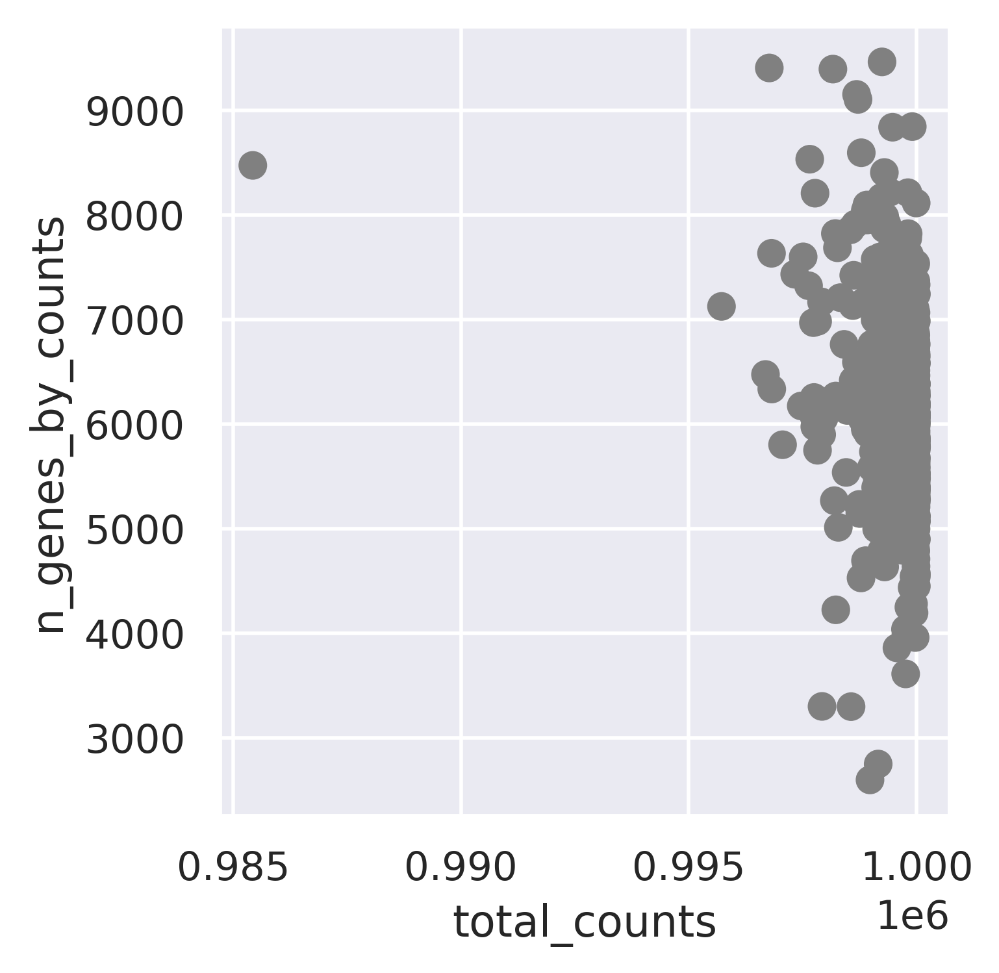

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (460, 13899)
#----------------------------------------------
Deal with P14...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (418, 19744)


<Figure size 3000x600 with 0 Axes>

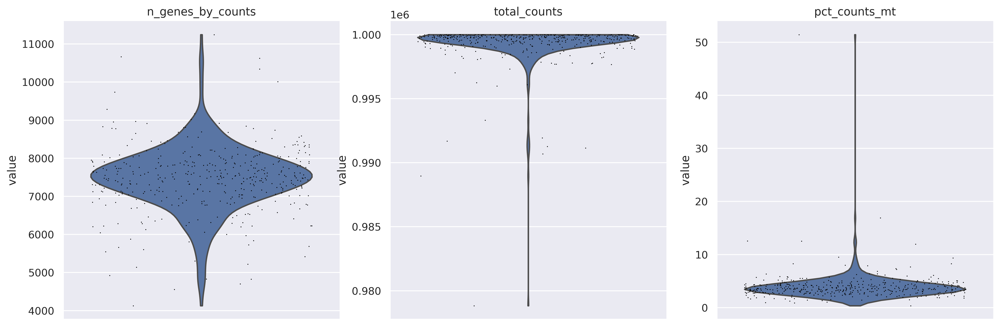

<Figure size 1600x1200 with 0 Axes>

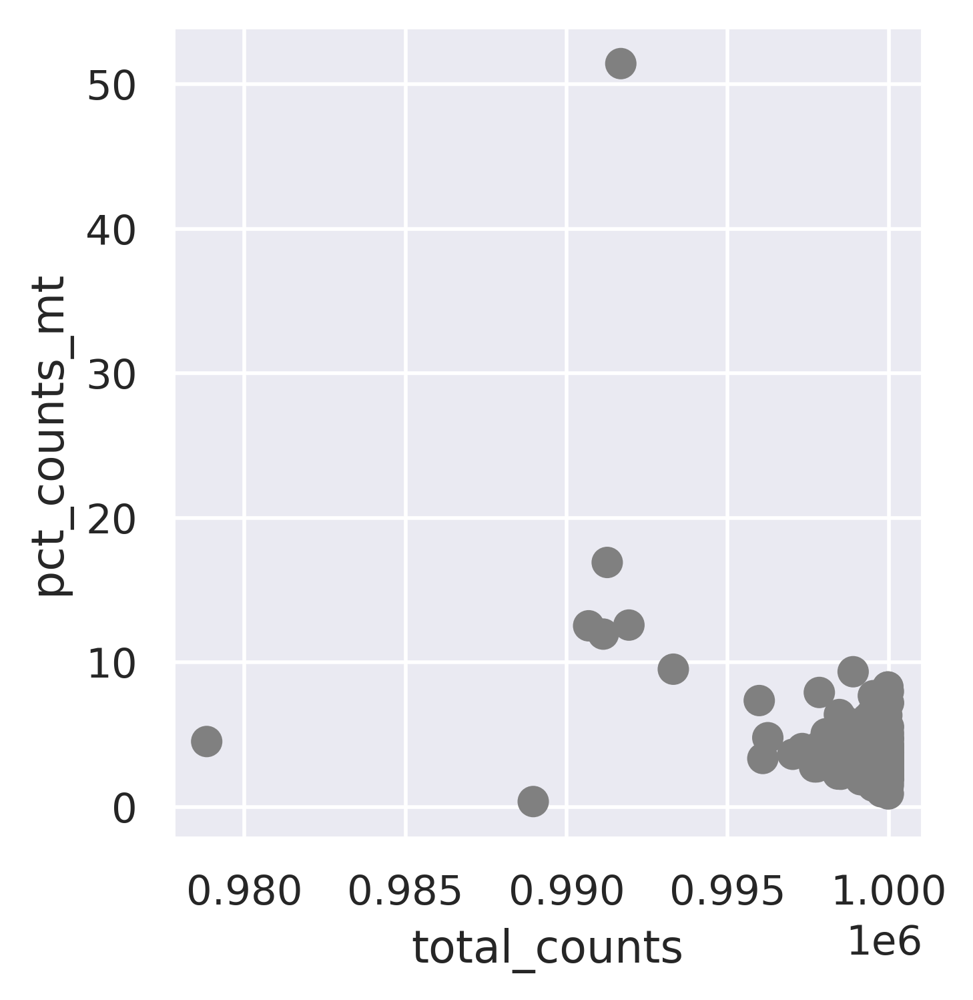

<Figure size 1600x1200 with 0 Axes>

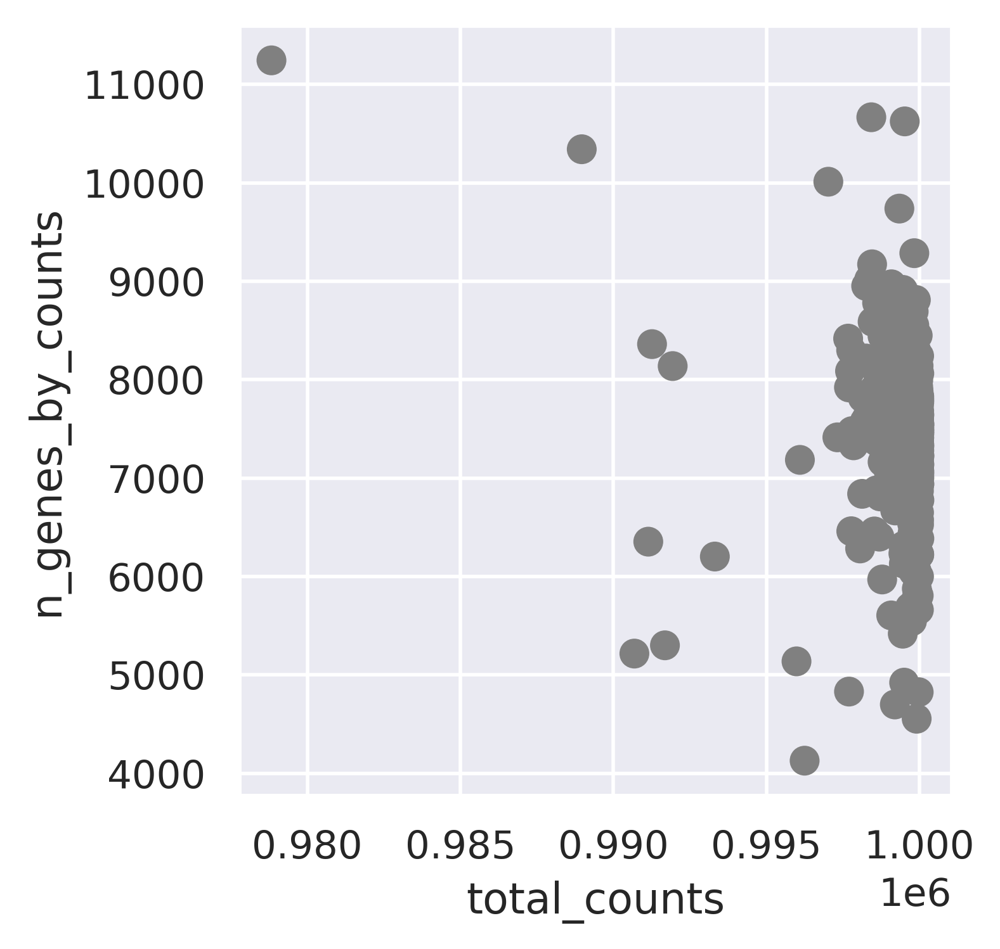

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (408, 13899)
#----------------------------------------------
Deal with P15...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1037, 19744)


<Figure size 3000x600 with 0 Axes>

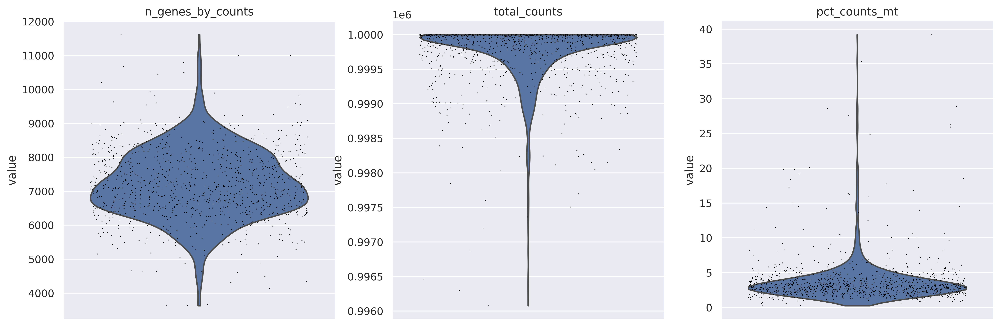

<Figure size 1600x1200 with 0 Axes>

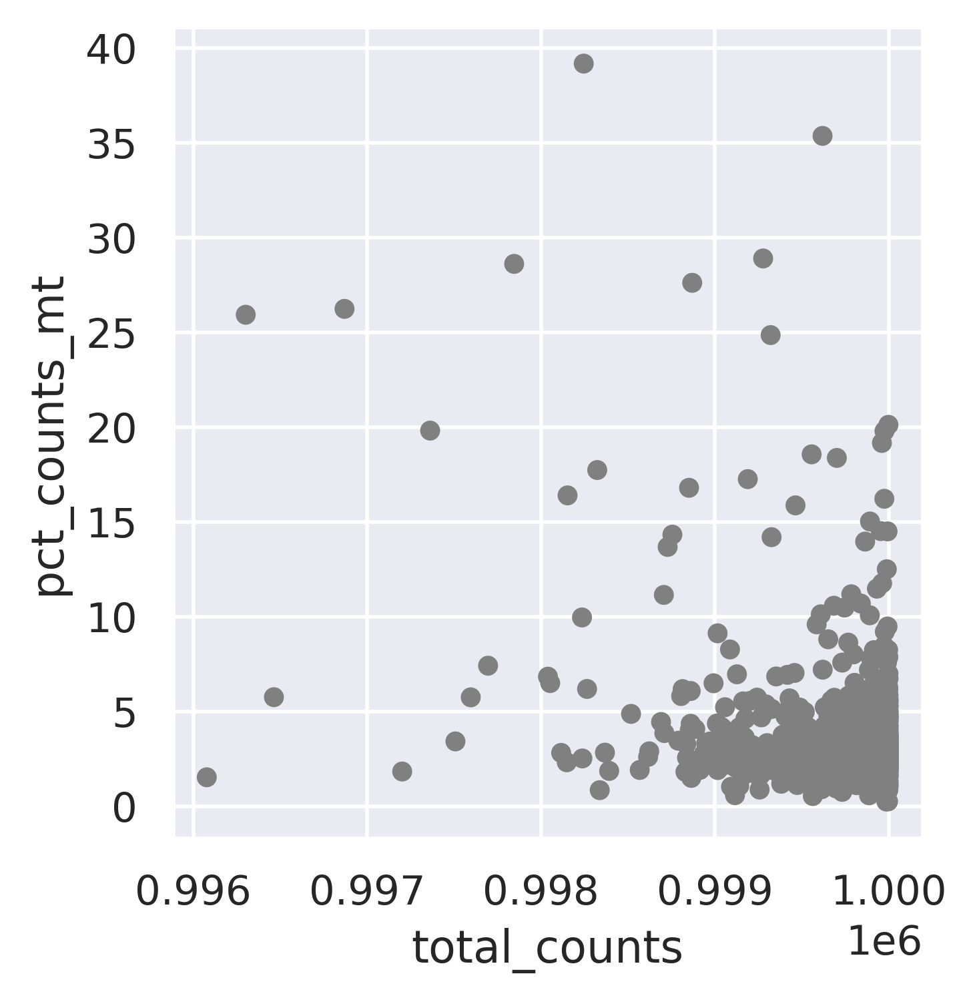

<Figure size 1600x1200 with 0 Axes>

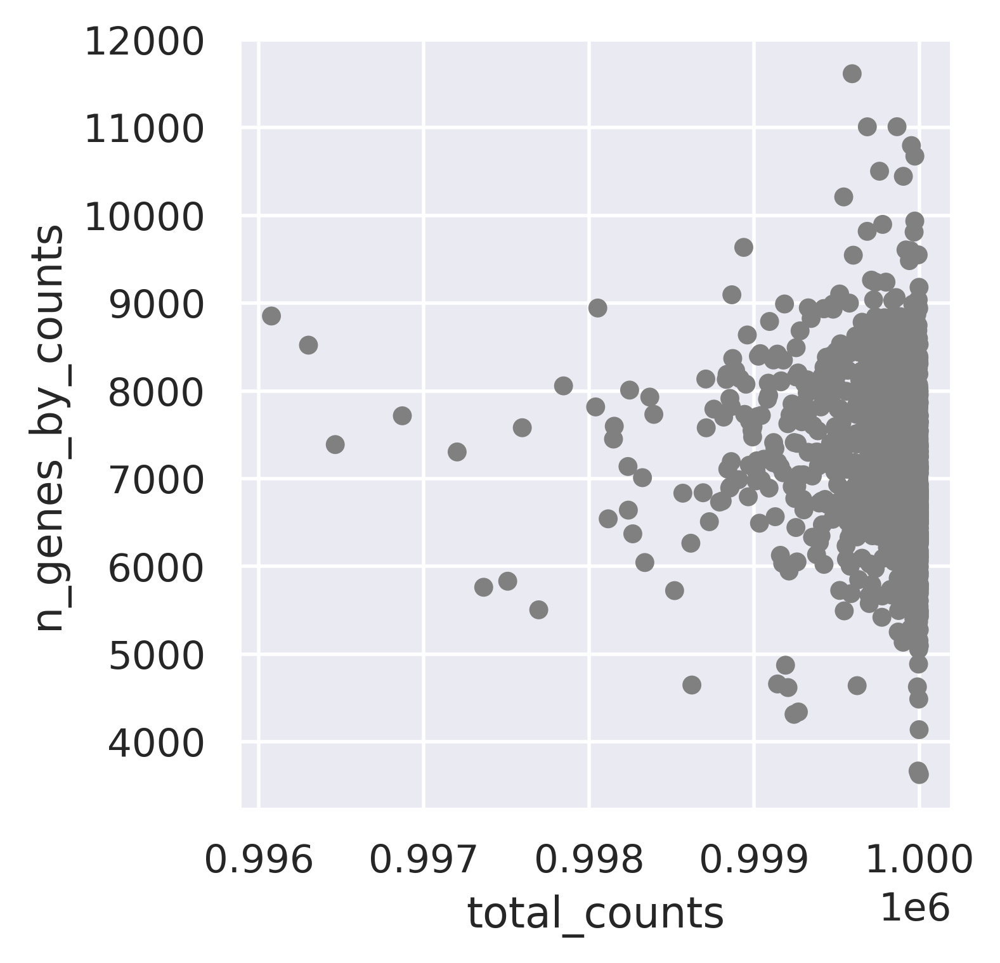

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (994, 15032)
#----------------------------------------------
Deal with P16...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1313, 19744)


<Figure size 3000x600 with 0 Axes>

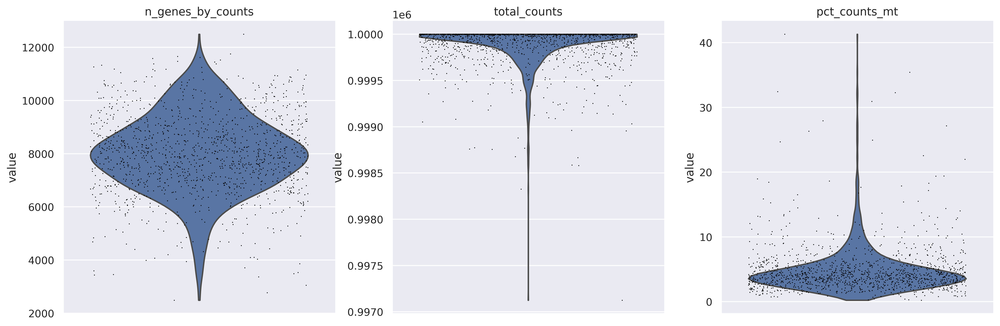

<Figure size 1600x1200 with 0 Axes>

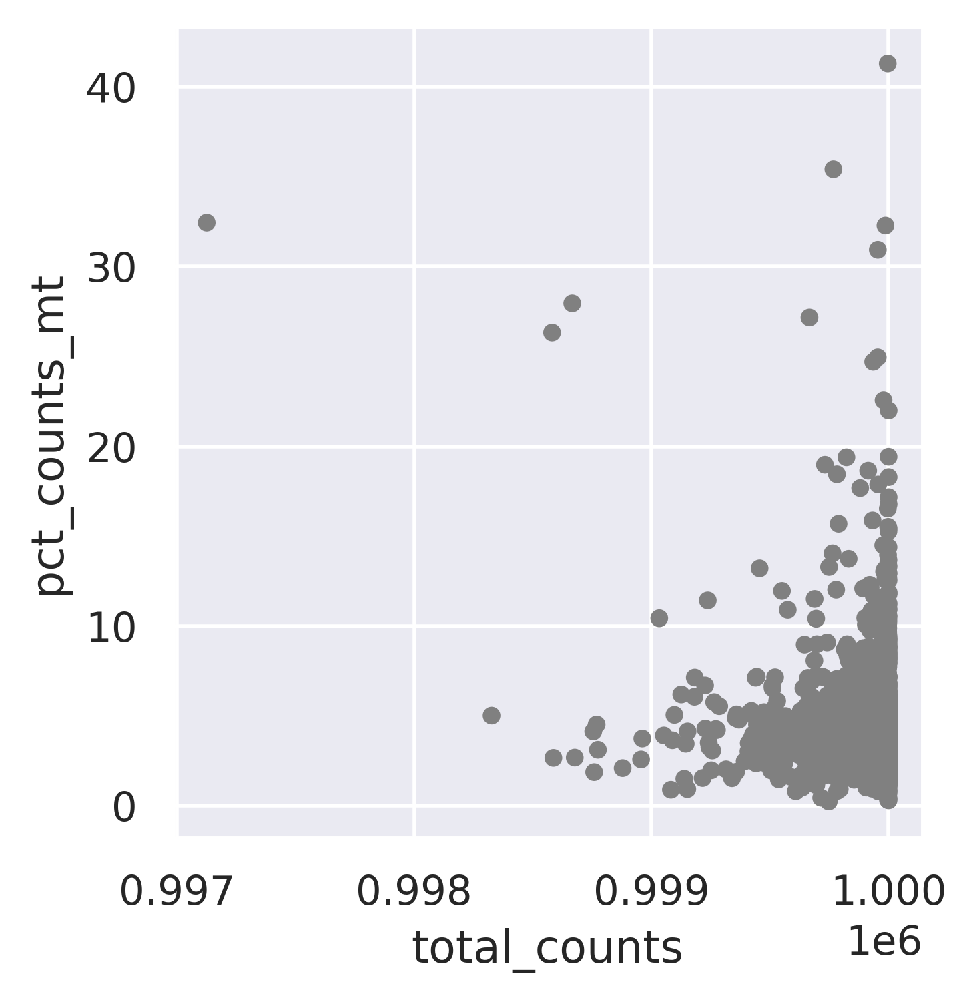

<Figure size 1600x1200 with 0 Axes>

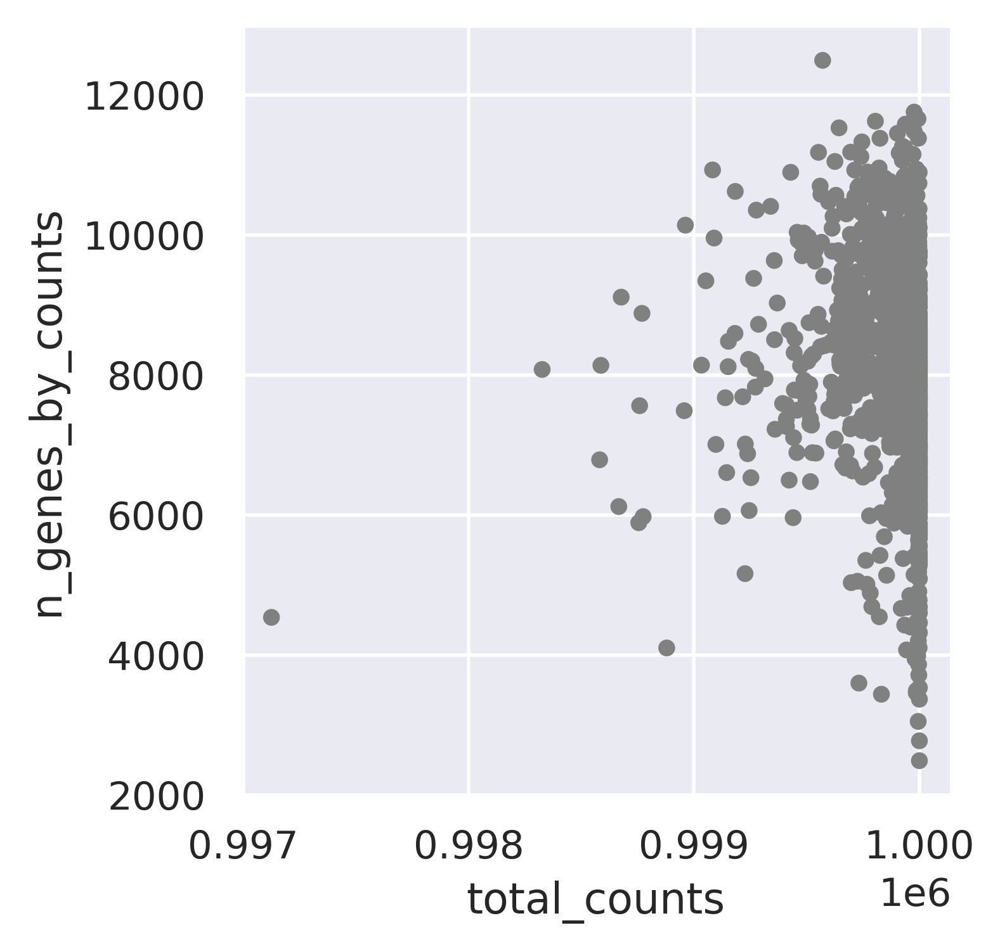

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (1112, 16517)
#----------------------------------------------
Deal with P17...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (135, 19744)


<Figure size 3000x600 with 0 Axes>

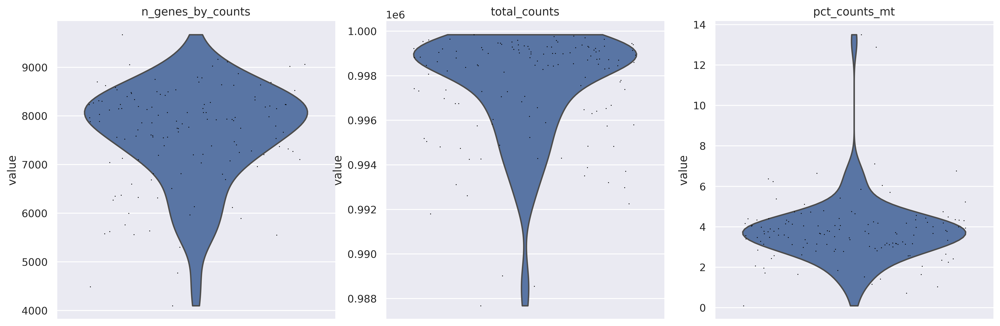

<Figure size 1600x1200 with 0 Axes>

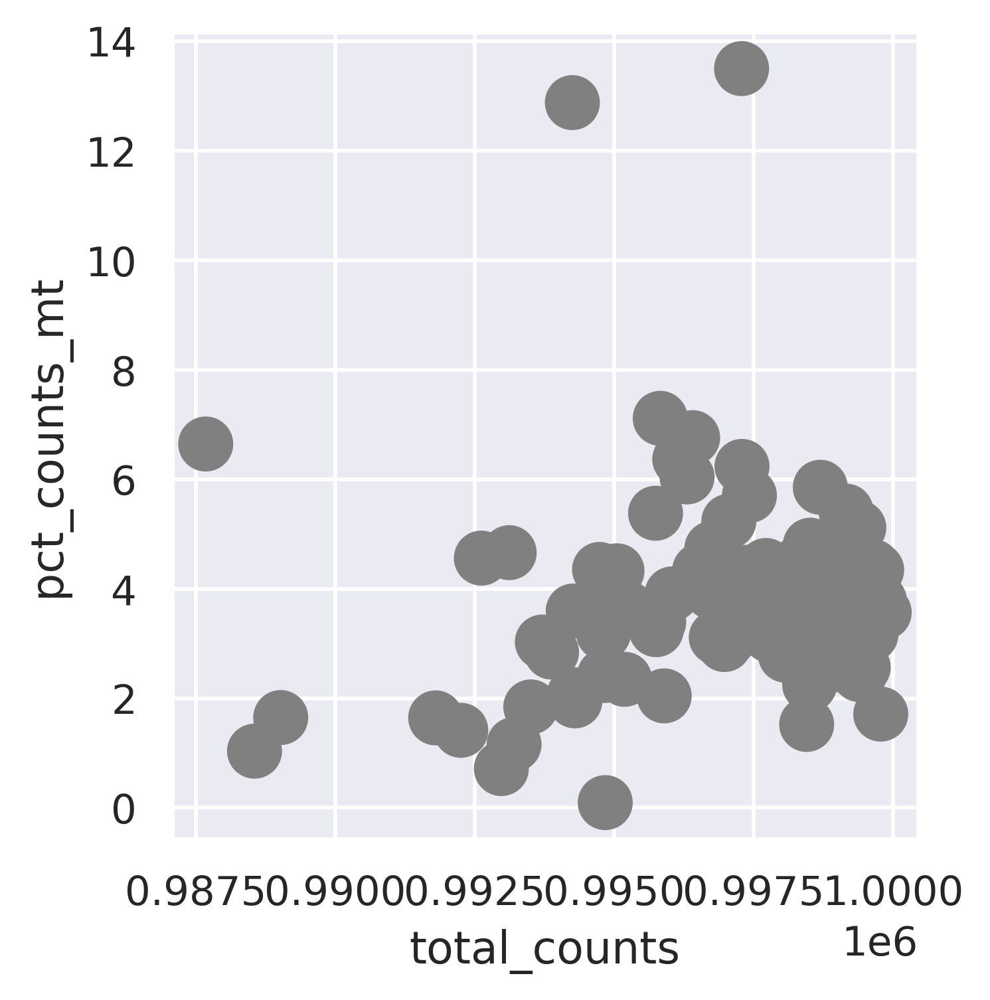

<Figure size 1600x1200 with 0 Axes>

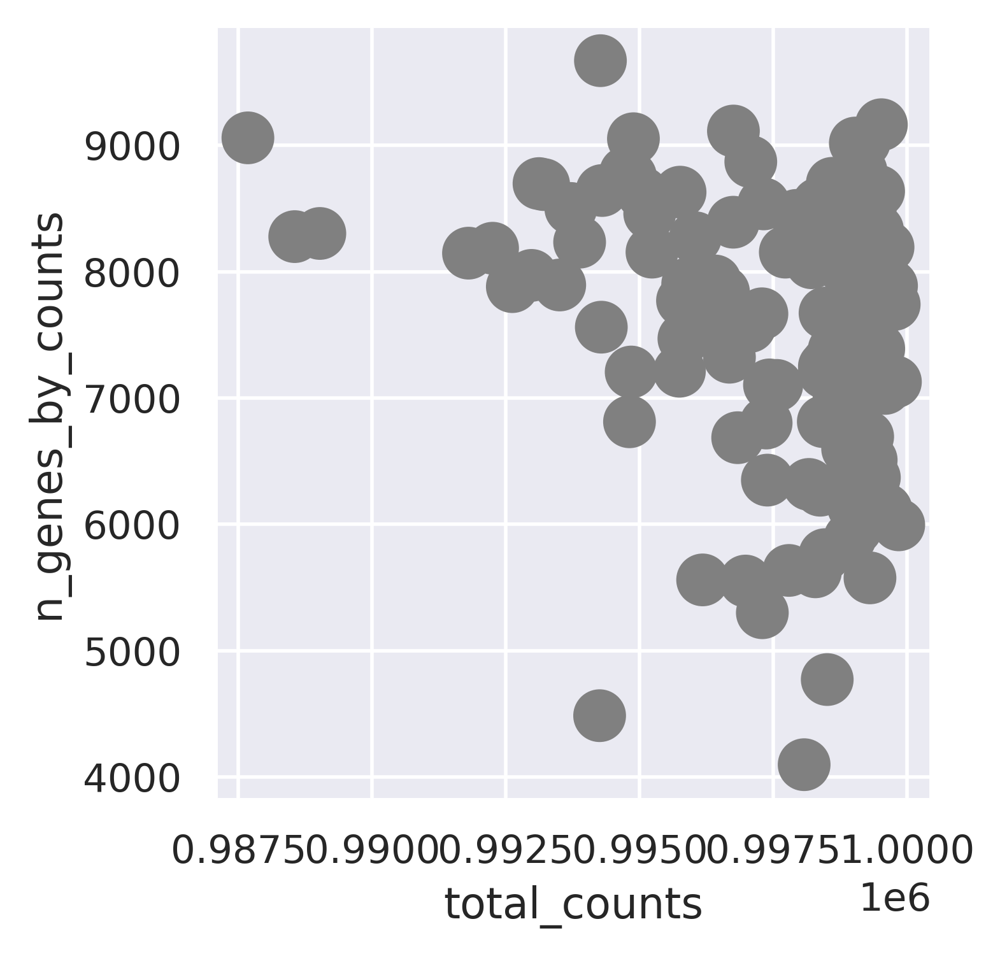

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (133, 13132)
#----------------------------------------------
Deal with P18...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (1082, 19744)


<Figure size 3000x600 with 0 Axes>

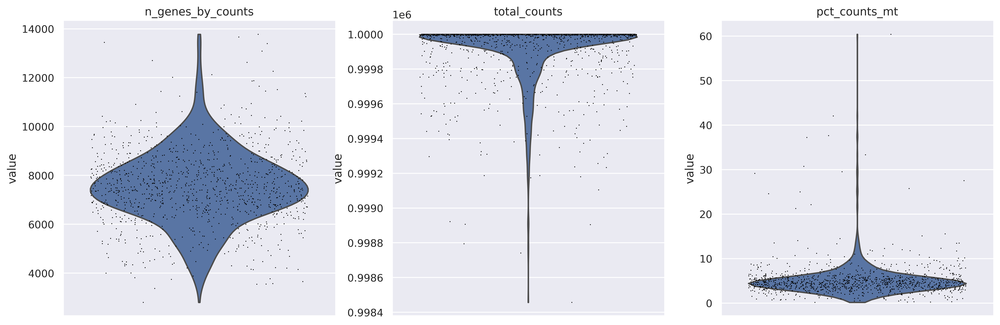

<Figure size 1600x1200 with 0 Axes>

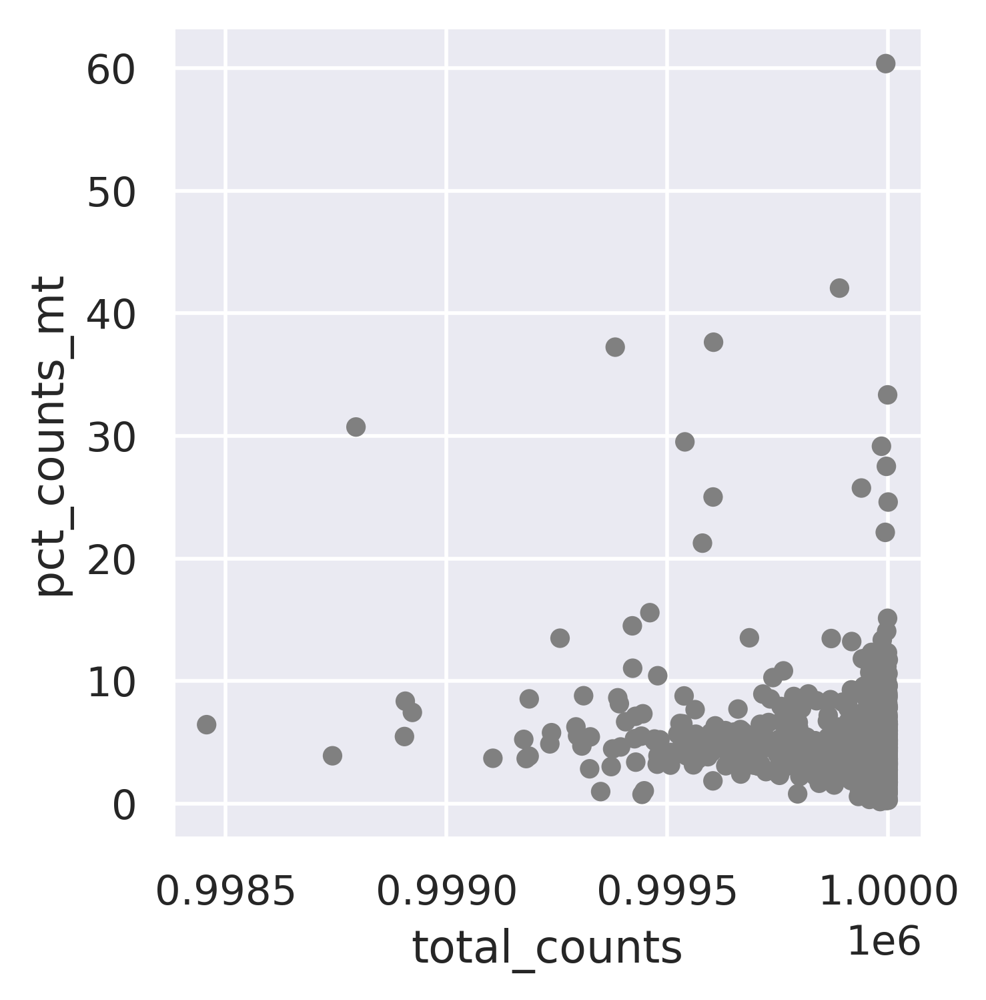

<Figure size 1600x1200 with 0 Axes>

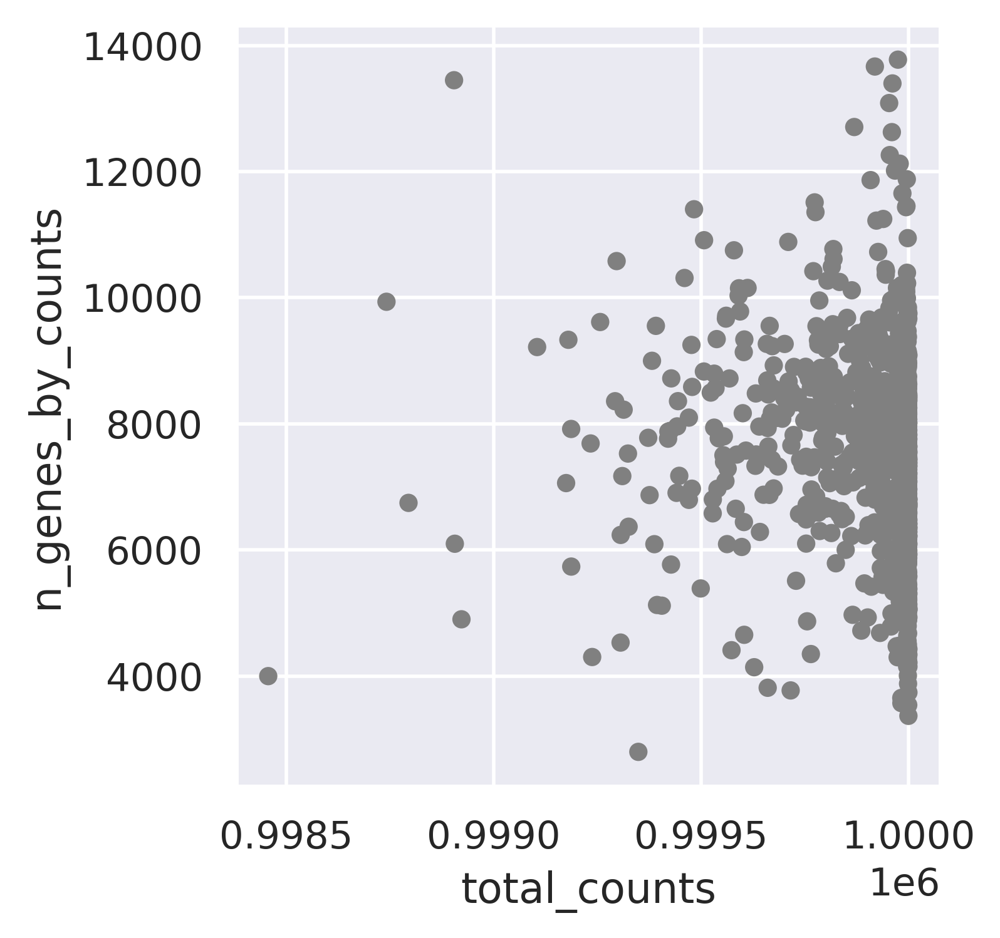

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


   The shape of adata after filtering is: (997, 15933)
#----------------------------------------------
Deal with P19...
<class 'anndata._core.views.SparseCSRView'>
   The shape of adata before filtering is: (108, 19744)


<Figure size 3000x600 with 0 Axes>

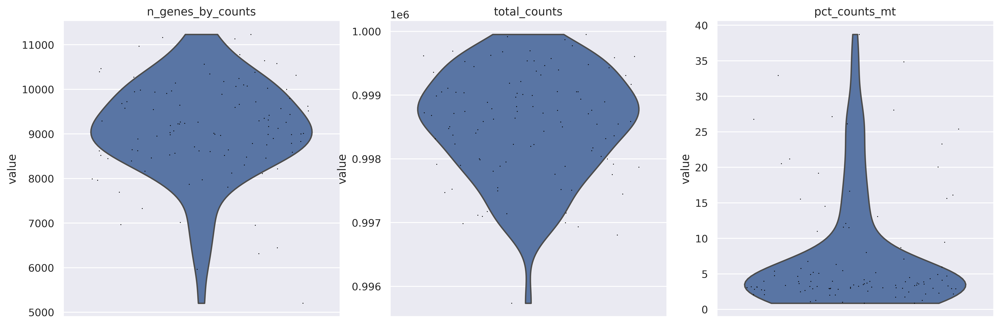

<Figure size 1600x1200 with 0 Axes>

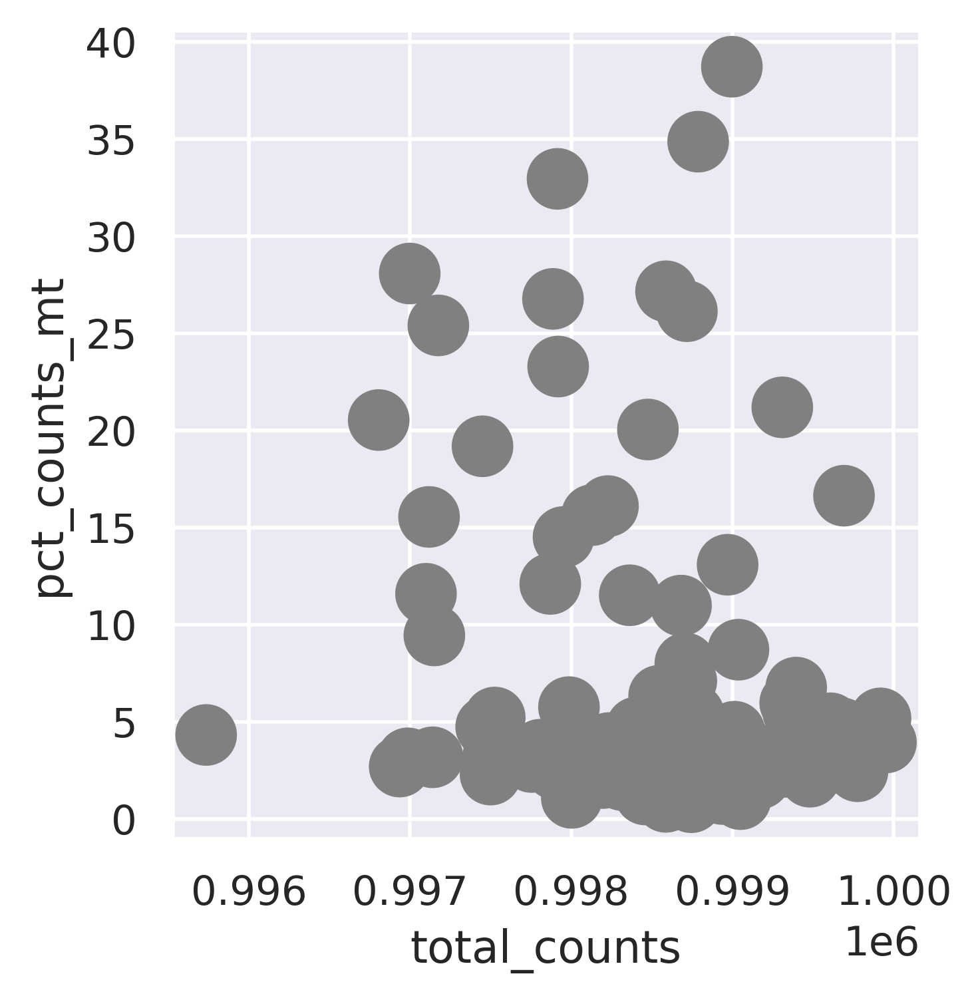

<Figure size 1600x1200 with 0 Axes>

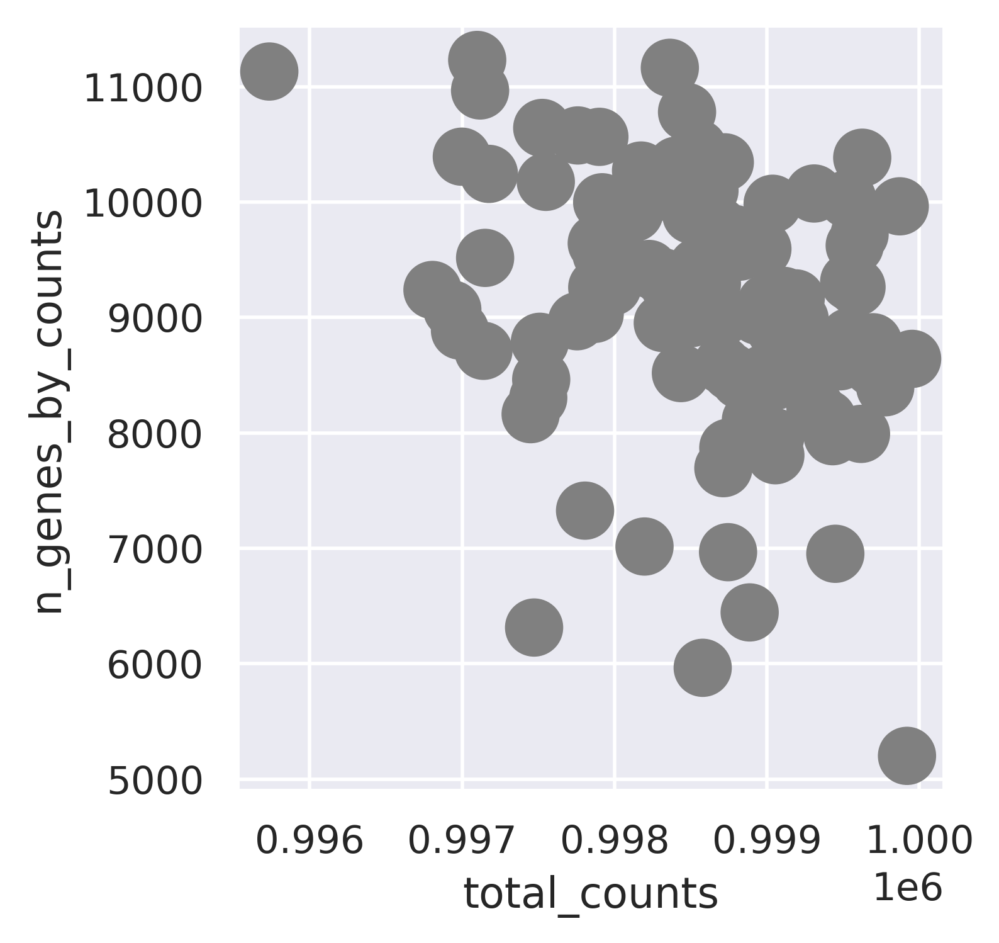

   The shape of adata after filtering is: (72, 13617)


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/preprocessing/_normalization.py:155: UserWarning: Revieved a view of an AnnData. Making a copy.
  view_to_actual(adata)


In [14]:
sample_number_afterfilter = 0
for _file in all_files:

    print('#----------------------------------------------')
    print('Deal with {}...'.format(_file))
    current_sample = all_dataset[all_dataset.obs['sample_id']==_file, :]
    print(type(current_sample.X))
    current_sample_normalized = normalize_mtx(adata=current_sample, result_dir=result_dir, prefix='', fig_prefix=_file, target_sum=1e6,
                                              max_n_genes_by_counts=10000, max_pct_counts_mt=10, max_total_counts=1e6+100, log_base=2, 
                                              filter_genes=True, min_cells=10)   
    sample_number_afterfilter += current_sample_normalized.shape[0]
    current_sample_normalized.write(os.path.join(result_dir, _file+'_raw.h5ad'))


In [15]:
print(sample_number_afterfilter)

13183


In [16]:
#P01,P19
sample2dataset = {}
for _file in all_files:
    if _file not in ['P01', 'P19']:  # remove samples since the total counts distribution
        current_file_path = os.path.join(result_dir, _file + '_raw.h5ad')
        current_dataset = sc.read_h5ad(current_file_path, backed=None)
        if current_dataset.shape[0] >= 1:
            # current_dataset.obs['sample'] = _file    
            sample2dataset[_file] = current_dataset
        else:
            print('Remove file {} with shape: {}'.format(_file, current_dataset.shape()))

In [17]:
sample2dataset['P17'].obs

,sample_id,source,disease,cell_type,cell_subtype_clusters,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
cell_name,,,,,,,,,,,
P17_T_0002,P17,Tumor,Primary_HCC,Myeloid,C8_Mye.,6403,6403,6350,997386.479490,36617.001605,3.671295
P17_T_0003,P17,Tumor,Primary_HCC,T_cell,C1_Tcell,6319,6319,6270,998375.031158,37710.413077,3.777179
P17_T_0004,P17,Tumor,Primary_HCC,Plasma,C22_Plasma,5590,5590,5551,996977.668704,29718.260442,2.980835
P17_T_0005,P17,Tumor,Primary_HCC,Myeloid,C2_Mye.,6791,6791,6686,996831.758261,31013.024982,3.111159
P17_T_0006,P17,Tumor,Primary_HCC,T_cell,C1_Tcell,8621,8621,8538,998336.355865,44786.107449,4.486074
...,...,...,...,...,...,...,...,...,...,...,...
P17_T_0378,P17,Tumor,Primary_HCC,Plasma,C22_Plasma,8012,8012,7927,996407.712930,67369.710403,6.761259
P17_T_0379,P17,Tumor,Primary_HCC,Malignant,C10_Tumor,8026,8026,7904,995897.496704,20343.715369,2.042752
P17_T_0380,P17,Tumor,Primary_HCC,T_cell,C1_Tcell,8180,8180,8071,998212.562595,40358.823872,4.043109



2 mergering all samples together
https://anndata.readthedocs.io/en/latest/anndata.AnnData.concatenate.htmlr

In [18]:
len(sample2dataset)

16

In [19]:
all_dataset = None
all_dirs = list(sample2dataset.keys())
count=0
for i in range(len(sample2dataset)-1):
    print('dealing with {}'.format(all_dirs[i]))
    next_dataset = sample2dataset[all_dirs[i+1]]
    count+=1
    if all_dataset is None:
        current_dataset = sample2dataset[all_dirs[i]]
        all_dataset = current_dataset.concatenate(next_dataset, index_unique=None, join='outer')

    else:
        all_dataset = all_dataset.concatenate(next_dataset, index_unique=None, join='outer')


dealing with P02


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:1763: FutureWarning: The AnnData.concatenate method is deprecated in favour of the anndata.concat function. Please use anndata.concat instead.

See the tutorial for concat at: https://anndata.readthedocs.io/en/latest/concatenation.html
  warnings.warn(


dealing with P03
dealing with P04
dealing with P05
dealing with P07
dealing with P08
dealing with P09
dealing with P10
dealing with P11
dealing with P12
dealing with P13
dealing with P14
dealing with P15
dealing with P16
dealing with P17


In [20]:
all_dataset

AnnData object with n_obs × n_vars = 13036 × 17764
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mt-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'n_cells_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mean_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'pct_dropout_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'n_cells-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mt-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'total_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0', 'n_cells-1-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mt-1-0-0-0-0-0-0-0-0-0-0-0-0-0', 'n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0', 'mean_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0', 'pct_dropout_by_counts-1-0-0-0-0-0-0-0-0

In [21]:
print(all_dataset.shape)
all_dataset.obs

(13036, 17764)


,sample_id,source,disease,cell_type,cell_subtype_clusters,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch
cell_name,,,,,,,,,,,,
P02_T_0001,P02,Tumor,Relapsed_HCC,Myeloid,C11_Mye.,8167,8167,8159,999451.892470,39794.724970,3.981655,0
P02_T_0002,P02,Tumor,Relapsed_HCC,Myeloid,C11_Mye.,9487,9487,9474,999936.935166,38723.342359,3.872578,0
P02_T_0003,P02,Tumor,Relapsed_HCC,Myeloid,C2_Mye.,9541,9541,9520,999443.711226,38545.312682,3.856677,0
P02_T_0004,P02,Tumor,Relapsed_HCC,Myeloid,C8_Mye.,7941,7941,7936,999944.700854,43605.199296,4.360761,0
P02_T_0005,P02,Tumor,Relapsed_HCC,Myeloid,C11_Mye.,9213,9213,9202,999651.098901,42226.419986,4.224116,0
...,...,...,...,...,...,...,...,...,...,...,...,...
P18_T_1574,P18,Tumor,Primary_HCC,B_cell,C6_Bcell,7353,7353,7348,999995.500593,52031.794841,5.203203,1
P18_T_1575,P18,Tumor,Primary_HCC,T_cell,C3_Tcell,6276,6276,6272,999999.136208,38396.862860,3.839690,1
P18_T_1576,P18,Tumor,Primary_HCC,T_cell,C0_Tcell,6227,6227,6221,999862.228189,67309.013370,6.731829,1


In [22]:
all_dataset.var.head(2)

,n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mt-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mean_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,pct_dropout_by_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,total_counts-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mt-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0,n_cells_by_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0,mean_counts-1-0-0-0-0-0-0-0-0-0-0-0-0-0-0,...,n_cells_by_counts-1-0,mean_counts-1-0,pct_dropout_by_counts-1-0,total_counts-1-0,n_cells-1,mt-1,n_cells_by_counts-1,mean_counts-1,pct_dropout_by_counts-1,total_counts-1
gene_name,,,,,,,,,,,,,,,,,,,,,
A1BG,687.0,False,687.0,47.733889,23.496659,42865.032330,935.0,False,935.0,27.449770,...,86.0,37.100311,36.296296,5008.542022,840.0,False,840.0,61.037979,22.365989,66043.093027
A1CF,197.0,False,197.0,11.427826,78.062361,10262.187632,168.0,False,168.0,1.414166,...,38.0,30.621145,71.851852,4133.854604,352.0,False,352.0,28.517323,67.467652,30855.743364


In [23]:
all_dataset.var.drop(columns=all_dataset.var.columns.to_list()[1:-1], inplace=True)
all_dataset.var = all_dataset.var.rename(columns={'n_cells-0-0-0-0-0-0-0-0-0-0-0-0-0-0-0': 'n_cells'})
all_dataset.var.head(2), all_dataset.var.shape

(           n_cells  total_counts-1
 gene_name                         
 A1BG         687.0    66043.093027
 A1CF         197.0    30855.743364,
 (17764, 2))

In [24]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}.h5ad'))

#### Filter genes by annotation file
- only keep `protein_coding` genes

In [25]:
gene_list_in_bulk = pd.read_csv(r'../data/3CA/gencode.gene.info.v22.tsv', index_col=0, sep='\t')
gene_list_in_bulk = gene_list_in_bulk.loc[gene_list_in_bulk['gene_type'] == 'protein_coding', :].copy()
print(gene_list_in_bulk.shape)
gene_list_in_bulk.head(2)

(19814, 11)


,gene_name,seqname,start,end,strand,gene_type,gene_status,havana_gene,full_length,exon_length,exon_num
gene_id,,,,,,,,,,,
ENSG00000206557.5,TRIM71,chr3,32818018,32897826,+,protein_coding,KNOWN,OTTHUMG00000155778.3,79809,8685,4
ENSG00000183813.6,CCR4,chr3,32951574,32956349,+,protein_coding,KNOWN,OTTHUMG00000130752.2,4776,3095,2


In [26]:
common_marker_gene = pd.read_csv('../data/3CA/selected_marker_genes.csv', index_col=0)
print(common_marker_gene.shape)
common_marker_gene.head(2)

(178, 6)


,cell_type,subset,PMID,comment,core_marker,corr_mean
marker_gene,,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN,NaN


In [27]:
len(set(all_dataset.var.index) & set(gene_list_in_bulk['gene_name'])), len(set(all_dataset.var.index) & set(common_marker_gene.index)), gene_list_in_bulk.shape, all_dataset.var.shape

(17215, 168, (19814, 11), (17764, 2))

In [28]:
# genes in bulk gene list or marker genes
bulk_marker = set(gene_list_in_bulk['gene_name']) | set(common_marker_gene.index)
len(bulk_marker)

19714

In [29]:
all_dataset = all_dataset[:, all_dataset.var.index.isin(bulk_marker)]
all_dataset

View of AnnData object with n_obs × n_vars = 13036 × 17215
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


17.722


AnnData object with n_obs × n_vars = 13036 × 17215
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'

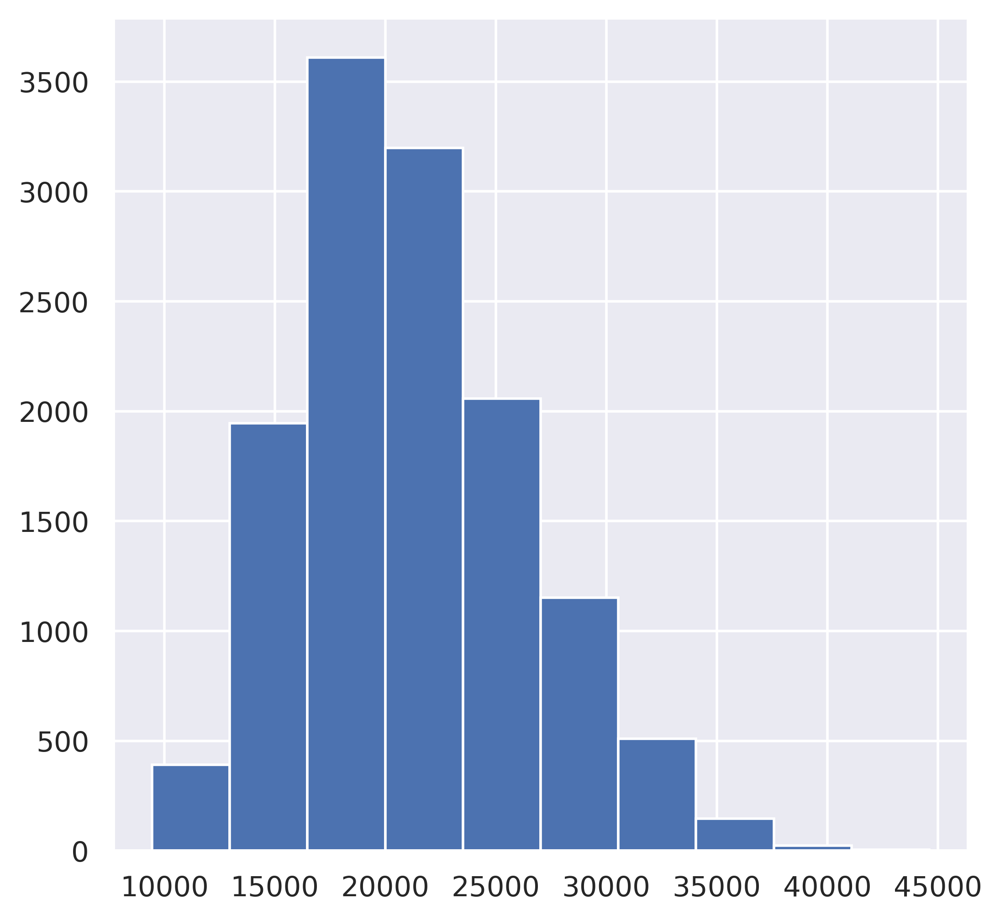

In [30]:
data = pd.DataFrame(all_dataset.X.todense())
data = log_exp2cpm(exp_df=data, log_base=2, correct=1)
data = non_log2log_cpm(input_file_path=data,  correct=1,transpose =False)
all_dataset_1 = an.AnnData(data)
all_dataset_1.X = csr_matrix(all_dataset_1.X)
all_dataset_1.obs = all_dataset.obs
all_dataset_1.var = all_dataset.var
all_dataset = all_dataset_1.copy()
print(data.max().max())  #check 
plt.figure(figsize=(6,6))
plt.hist(np.around(np.array(data.sum(axis=1)),0))
all_dataset

### 3. Principal component analysis
- Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.

In [31]:
sc.tl.pca(all_dataset, svd_solver='arpack', n_comps=100, use_highly_variable=False, zero_center=False)

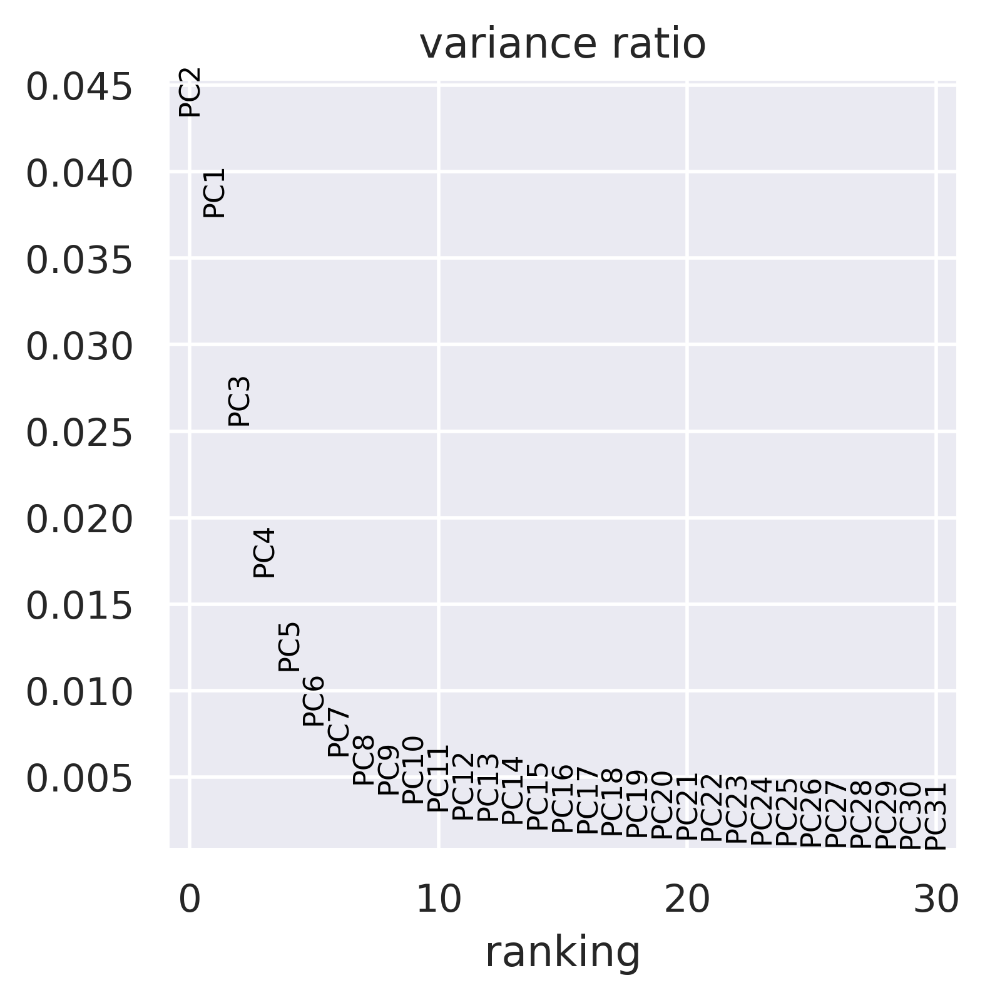

In [32]:
sc.pl.pca_variance_ratio(all_dataset, n_pcs=30)

In [33]:
all_dataset.obsm['X_pca'].shape

(13036, 100)

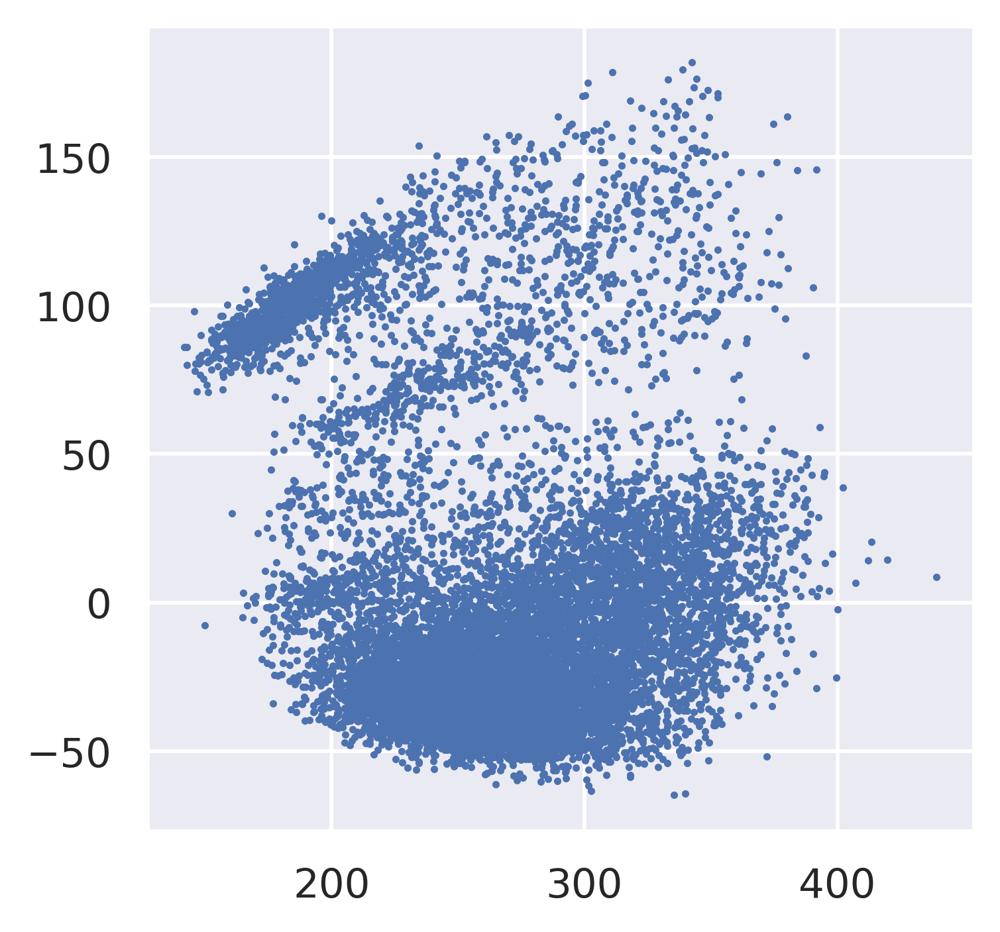

In [34]:
plt.scatter(all_dataset.obsm['X_pca'][:, 0], all_dataset.obsm['X_pca'][:, 1],s=1)

### 4. Computing the neighborhood graph and Embedding the neighborhood graph

In [35]:
sc.pp.neighbors(all_dataset, n_neighbors=10, n_pcs=40)

In [36]:
sc.tl.umap(all_dataset)

In [37]:
all_dataset

AnnData object with n_obs × n_vars = 13036 × 17215
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch'
    var: 'n_cells', 'total_counts-1'
    uns: 'pca', 'neighbors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [38]:
sc.tl.leiden(all_dataset)

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


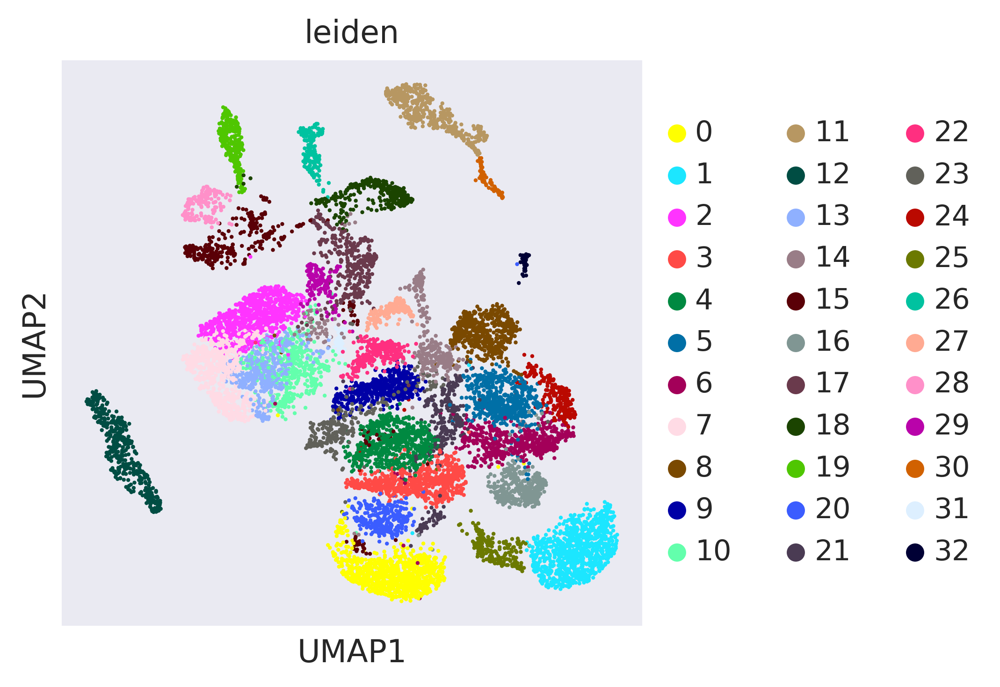

In [39]:
sc.pl.umap(all_dataset, color=['leiden'], save='before_batch_correct_umap_leiden.png')

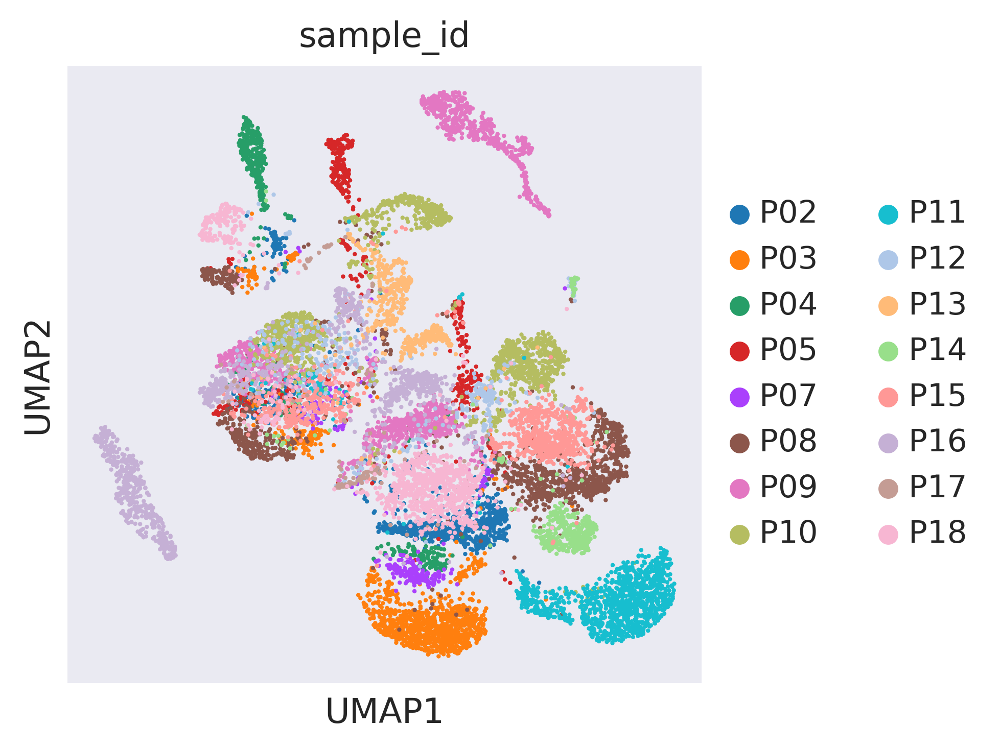

In [40]:
sc.pl.umap(all_dataset, color=['sample_id'], save='before_batch_correct_umap_batch.png')

In [41]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_before_batch_correction.h5ad'))

5. Batch effect correction by BBKNN¶
https://scanpy-tutorials.readthedocs.io/en/latest/integrating-data-using-ingest.html#BBKNN

In [42]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}_before_batch_correction.h5ad'))

In [43]:
%%time
sc.external.pp.bbknn(all_dataset, batch_key='sample_id')

CPU times: user 10.5 s, sys: 267 ms, total: 10.8 s
Wall time: 5.46 s


In [44]:
all_dataset

AnnData object with n_obs × n_vars = 13036 × 17215
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_id_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [45]:
%%time
sc.tl.umap(all_dataset)
sc.tl.leiden(all_dataset)

CPU times: user 33.6 s, sys: 13.4 s, total: 46.9 s
Wall time: 31 s


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


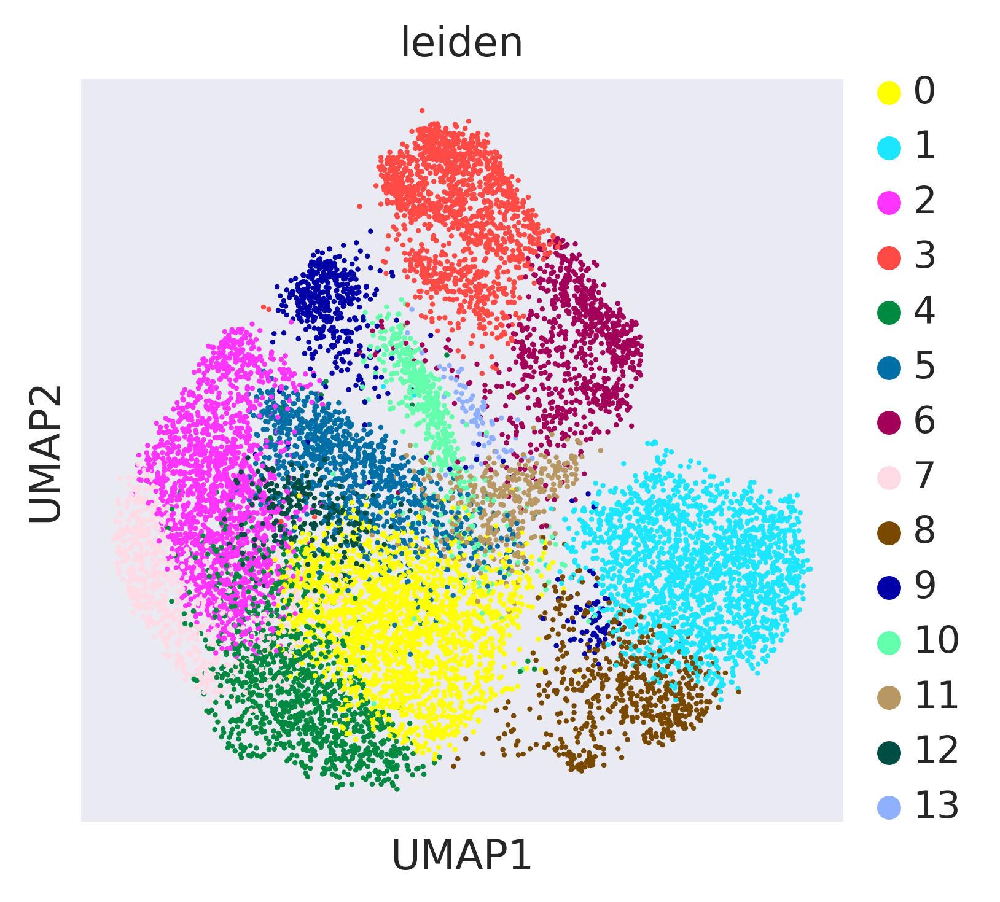

In [46]:
sc.pl.umap(all_dataset, color=['leiden'], save='after_batch_correct_umap_leiden.png')

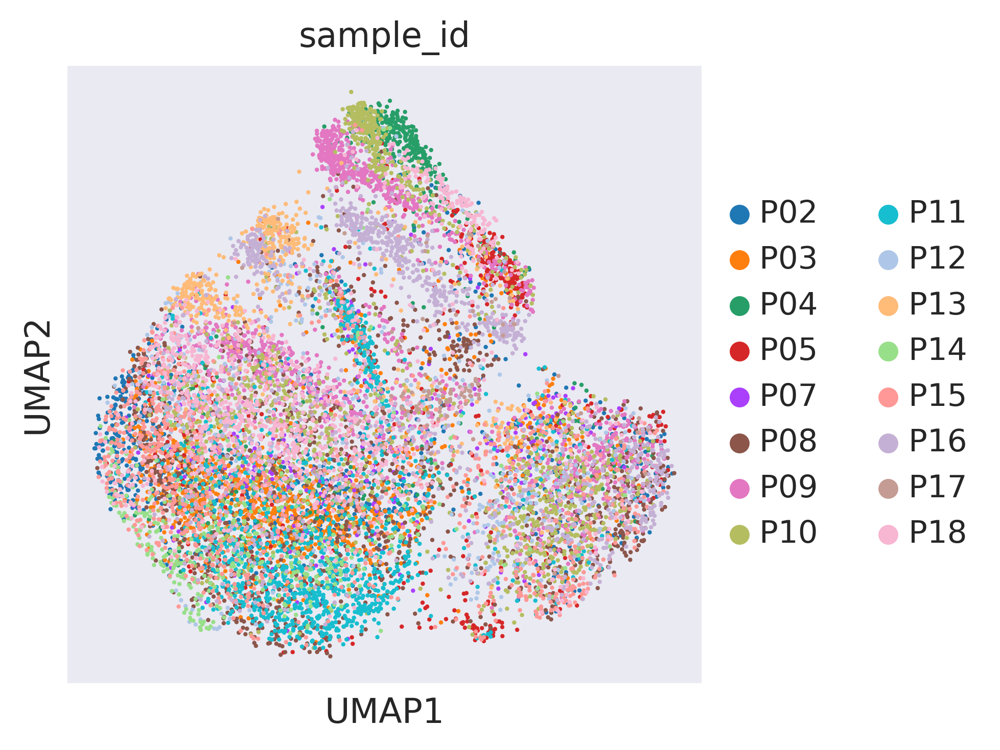

In [47]:
sc.pl.umap(all_dataset, color=['sample_id'], save='after_batch_correct_umap_batch.png')

In [48]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction_step5.h5ad'))

### 6. Finding marker genes

In [71]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}_after_batch_correction_step5.h5ad'))

In [72]:
sc.tl.rank_genes_groups(all_dataset, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(all_dataset, n_genes=25, sharey=False)

In [73]:
top30 = pd.DataFrame(all_dataset.uns['rank_genes_groups']['names']).head(30)
top30

,0,1,2,3,4,5,6,7,8,9,10,11,12,13
0,KLRB1,HLA-DRA,RPS27,APOA2,HNRNPH1,CARD16,CNN3,GNLY,ZNF8,AIF1,MS4A1,STMN1,CD8A,MZB1
1,TC2N,AIF1,B2M,APOA1,ZBTB8B,BATF,CALD1,GZMH,ZNF554,C1QA,CD74,HMGN2,CD8B,SSR4
2,IL7R,CST3,ARHGDIB,AMBP,ZNF793,IL32,CTTN,GZMB,CACNA1A,FCER1G,CD79A,TRMT5,NKG7,IGLL5
3,TRAT1,IFI30,CD3D,AKR1C2,S1PR3,CD27,NFIB,NKG7,SLC14A2,C1QB,TNFRSF13C,HMGB2,KLRC4-KLRK1,SEC11C
4,CD69,TYROBP,CD3G,AKR1C1,SAG,TIGIT,FN1,KLRD1,ZNF556,C1QC,BANK1,TK1,KLRK1,PRDX4
5,STAT4,IGSF6,CD2,AKR1C3,PDDC1,TBC1D4,RARRES2,PRF1,DSC3,CST3,BCL11A,CTD-2116N17.1,CTLA4,DERL3
6,PARP8,HLA-DRB1,SRGN,AKR1C4,C1orf61,CARD17,TJP1,FGFBP2,DISP2,TYROBP,HLA-DRA,TYMS,CD3D,FKBP11
7,RORA,CD74,CD3E,AGT,KANK2,TNFRSF18,AMBP,CCL5,L1TD1,IGSF6,IRF8,TUBA1B,GZMA,AC073610.5
8,BCL11B,FCER1G,CD52,RARRES2,ORAI2,LAIR2,KRT18,CST7,HES2,CD74,HLA-DRB5,TOP2A,CD27,XBP1
9,ALOX5AP,CD68,IL32,RBP4,POU5F1,CASP1,NFIA,CTSW,CDHR4,HLA-DRB1,HLA-DRB1,NUSAP1,RGS1,BLOC1S5-TXNDC5


In [74]:
common_marker_gene = pd.read_csv(r'../data/3CA/selected_marker_genes.csv', index_col=0)
common_marker_gene.head(2)

,cell_type,subset,PMID,comment,core_marker,corr_mean
marker_gene,,,,,,
PRSS1,Acinar,Acinar,31273297,pdac_pengj_02,NaN,NaN
PRSS1,Acinar cells,Acinar cells,"Steele, N.G. et al., Nat Cancer, 1097-1112, 2020",pdac_steele_04,NaN,NaN


In [75]:
for cluster_id in top30:
    print('Current cluster id: {}'.format(cluster_id))
    print('Cells number of current cluster: {}'.format(all_dataset.obs['leiden'].value_counts()[cluster_id]))
    print(top30.loc[:, [cluster_id]].merge(common_marker_gene, left_on=cluster_id, right_index=True).iloc[:, range(2)])

Current cluster id: 0
Cells number of current cluster: 2053
        0 cell_type
2    IL7R     CD4 T
5   STAT4     CD4 T
18   GZMA     CD8 T
Current cluster id: 1
Cells number of current cluster: 1871
         1                cell_type
1     AIF1              Macrophages
4   TYROBP              Macrophages
8   FCER1G              Macrophages
9     CD68              Macrophages
11     LYZ              Macrophages
17  MS4A6A              Macrophages
18  FCGR2A  Macrophages (discarded)
Current cluster id: 2
Cells number of current cluster: 1764
       2 cell_type
3   CD3D   T Cells
5    CD2   T Cells
7   CD3E   T Cells
13  GZMA     CD8 T
16  CCL5     CD8 T
Current cluster id: 3
Cells number of current cluster: 1469
        3         cell_type
2    AMBP      Ductal cells
26  KRT18  Epithelial Cells
26  KRT18  Epithelial Cells
Current cluster id: 4
Cells number of current cluster: 1143
Empty DataFrame
Columns: [4, cell_type]
Index: []
Current cluster id: 5
Cells number of current cluster: 9

In [76]:
marker_genes1 = ["PDCD1", "IFNG", "CD2", "CD3D", "CD3E", # T Cell
                 "BATF", "ICOS", "IL7R", "SELL", "TNFRSF4","CXCL13",  "CXCR5", "MAF", "IL12RB2", "STAT4", "CREM", "IRF4", "NR4A2",     
                 "GATA3", "STAT6", "TCF7", "IKZF2", "IL2RA", "TGFB1", "TGFB3", "TGFBR1", "CD28", "TNFRSF14", "TNFRSF9", 
                  "FOXP3","CTLA4", "TIGIT", "CCR7", "CD4",  # CD4 T                                                        
                 "CX3CR1", "CCL5", "CD8A", "CD8B", "GZMA", "LAYN", "LAG3", "GZMB", "GNLY", "NKG7", "PRF1", # CD8 T
                 "NCAM1", "XCL1", "KLRD1", "SAMD3", "TBX21"]  # NK

In [77]:
marker_genes2 = ["BANK1", "CD19", "CD22", "CD79A", "FCRL5", "FCRLA", "MS4A1", "SLAMF7", # B Cells
                 "CLEC10A", "LAMP3", "CD80", "CD83", "CLEC4C", "IRF8", "MZB1", "CD40", # DC
                 "CDH5", "CLDN5", "ENG", "PLVAP", "VWF", # Endothelial Cells
                 "COL1A1", "COL1A2", "COL3A1", "DCN", "FAP", "LUM", "MYL9",  # Fibroblasts
                 "AIF1", "CD14", "CD163", "CD68", "CTSB", "FCGR2A", "FCGR3B", "LYZ", "MARCO", "MS4A7", "FCGR3A", # Macrophages
                 "CMA1", "MS4A2", "TPSAB1", # Mast Cells
                 "CFLAR", "CSF3R", "CXCR2", "FPR1", "S100A8", "S100A9", "SLC25A37", # Neutrophils
                 "CDH1", "EPCAM", "KRT18", "KRT19", 'KRT5', 'KRT8']  # Epithelial cells

In [78]:

list_marker1 = set(all_dataset.var.index) & set(marker_genes1)
missing_gene = set(marker_genes1)-set(list_marker1)
print(f'Marker gene {missing_gene} of marker_genes1 list are missing.')
for i in missing_gene:
    marker_genes1.remove(i)
len(marker_genes1)

Marker gene set() of marker_genes1 list are missing.


50

In [79]:
list_marker2 = set(all_dataset.var.index) & set(marker_genes2)
missing_gene = set(marker_genes2)-set(list_marker2)
print(f'Marker gene {missing_gene} of marker_genes2 list are missing.')
for i in missing_gene:
    marker_genes2.remove(i)
len(marker_genes2)

Marker gene set() of marker_genes2 list are missing.


55

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


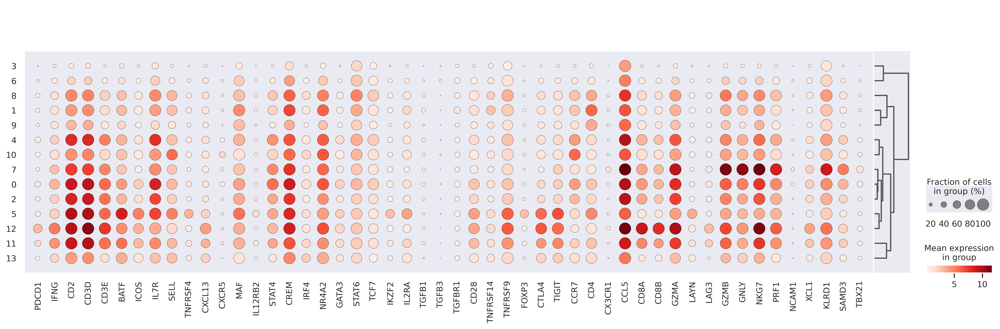

In [80]:
sc.pl.dotplot(all_dataset, marker_genes1, groupby='leiden', save='marker_genes_dotplot1.png', dendrogram=True)

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_dotplot.py:749: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


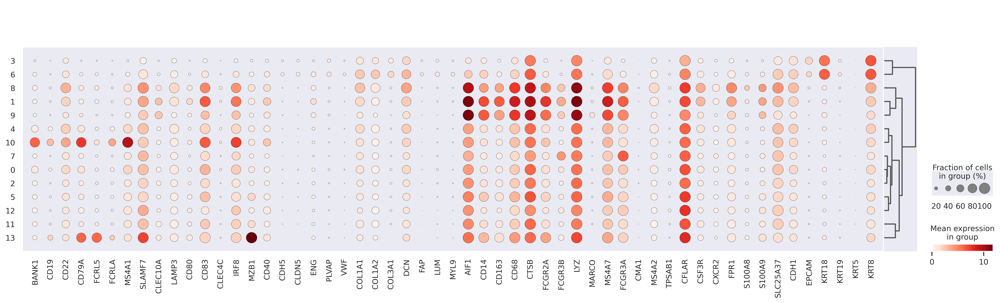

In [81]:
sc.pl.dotplot(all_dataset, marker_genes2, groupby='leiden', save='marker_genes_dotplot2.png', dendrogram=True)


/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


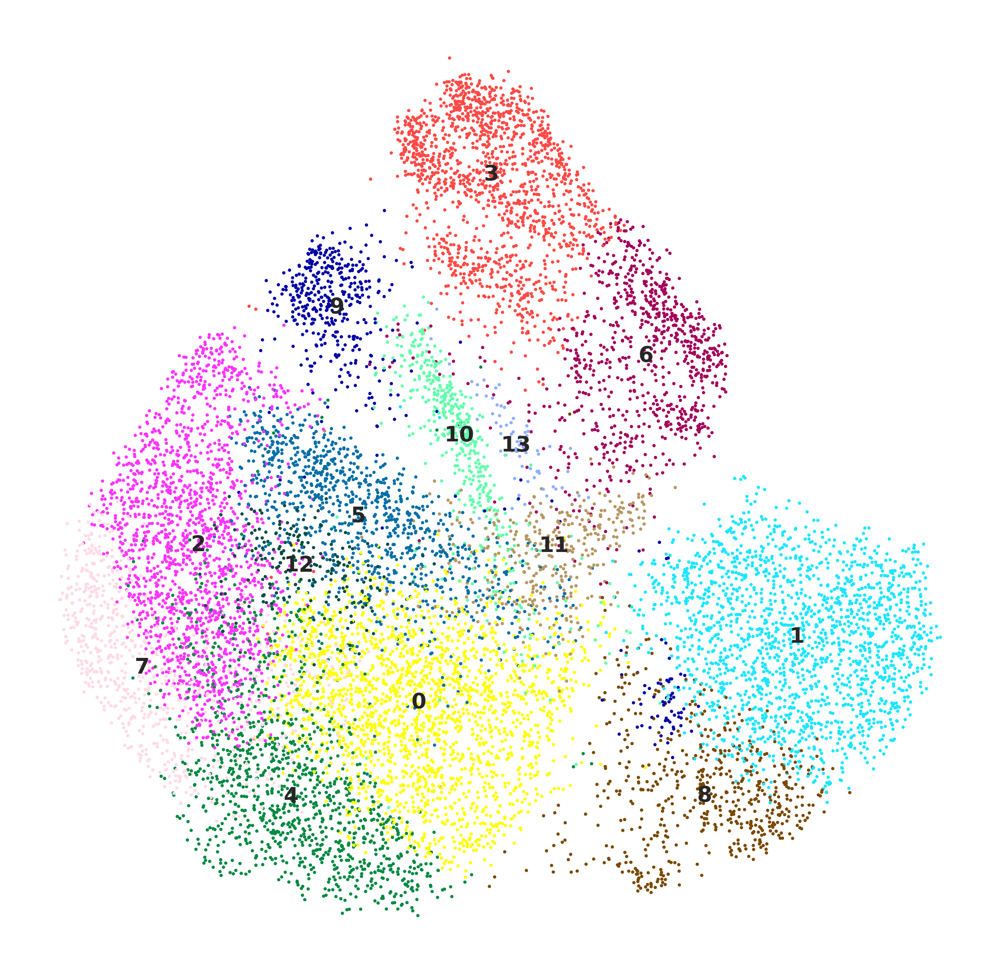

In [82]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='.png')

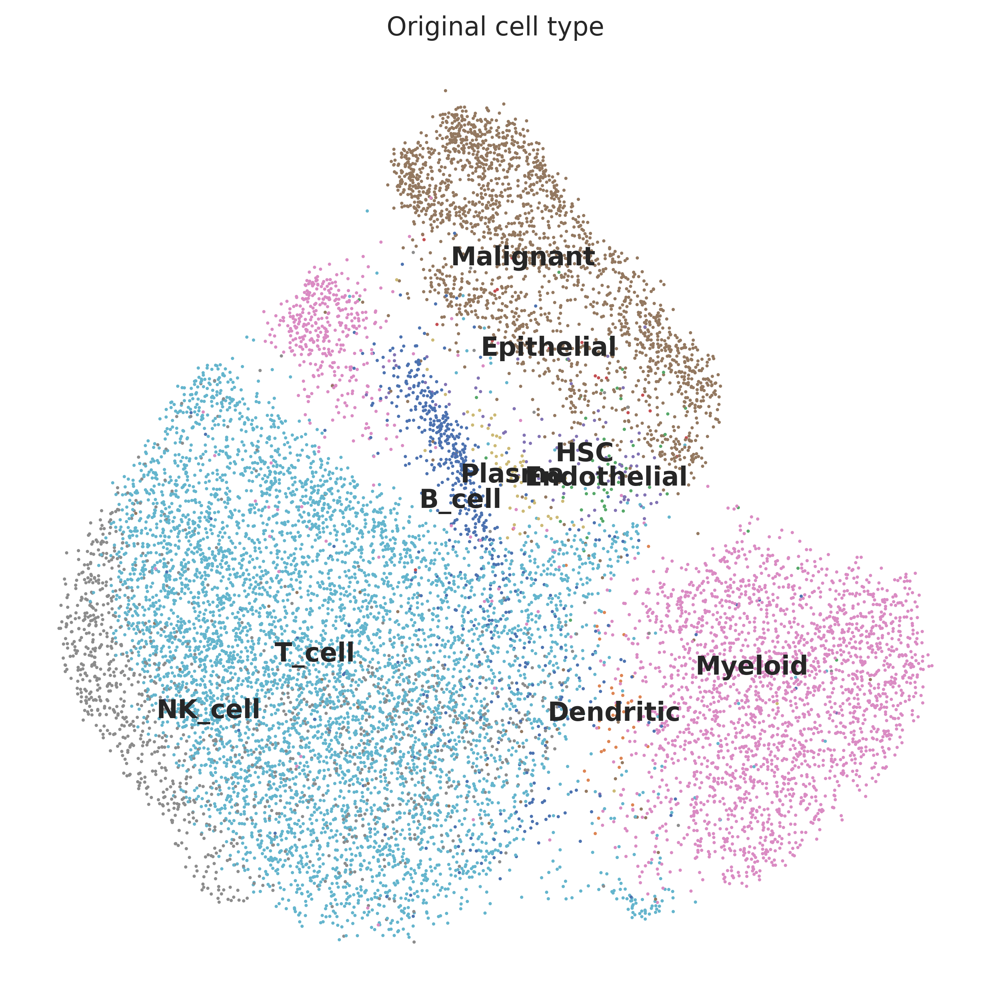

In [83]:
sc.pl.umap(all_dataset, color='cell_type', legend_loc='on data', legend_fontsize='medium', title='Original cell type', frameon=False, save='literature.png')

In [84]:
all_dataset.obs['cell_type'].value_counts()

T_cell         5953
Myeloid        2758
Malignant      2131
NK_cell        1274
B_cell          632
HSC             100
Plasma           67
Endothelial      62
Dendritic        38
Epithelial       21
Name: cell_type, dtype: int64

In [85]:
#  Exhausted CD8 T (Tex)
# follicular T helper (Tfh)
# Plasmacytoid dendritic cells (pDC)
new_cluster_names = {
    0: 'CD4 T',
    1: 'Macrophages (1)',   
    2: 'CD8 T (1)',
    3: 'Epithelial Cells (1)',
    4: 'Biliary_LIHC_1',
    5: 'CD4 T / CD8 T',
    6: 'Epithelial Cells (2)',
    7: 'NK',
    8: 'Biliary_LIHC_2',
    9: 'Macrophages (2)',
    10: 'B Cells (1)',
    11: "Biliary_LIHC_3",
    12:'CD8 T (2)',
    13: 'B Cells (2)'
}
new_cluster_names_val = list(new_cluster_names.values())
print(new_cluster_names_val)
all_dataset.rename_categories('leiden', new_cluster_names_val)

['CD4 T', 'Macrophages (1)', 'CD8 T (1)', 'Epithelial Cells (1)', 'Biliary_LIHC_1', 'CD4 T / CD8 T', 'Epithelial Cells (2)', 'NK', 'Biliary_LIHC_2', 'Macrophages (2)', 'B Cells (1)', 'Biliary_LIHC_3', 'CD8 T (2)', 'B Cells (2)']


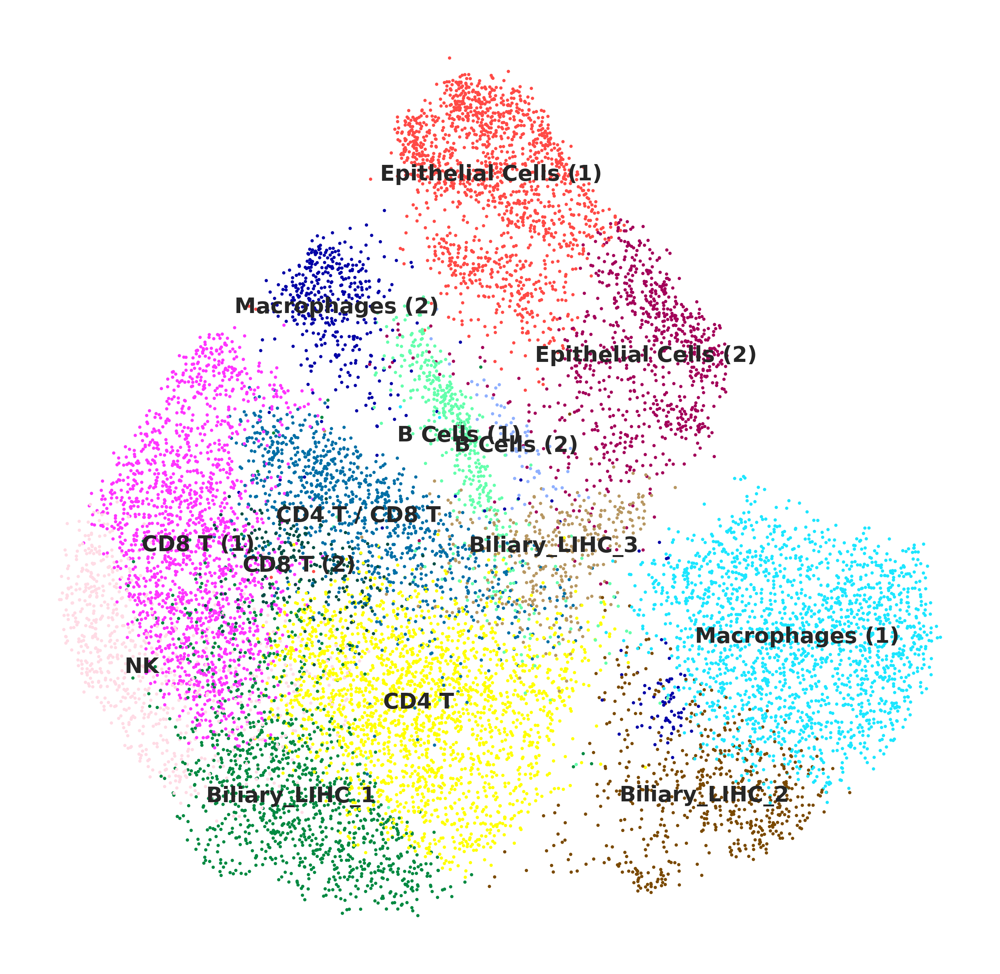

In [86]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='.png')

In [87]:
all_dataset

AnnData object with n_obs × n_vars = 13036 × 17215
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'leiden_colors', 'neighbors', 'pca', 'sample_id_colors', 'umap', 'rank_genes_groups', 'dendrogram_leiden', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [88]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction.h5ad'))

#### Comparing original cell type and annotated cell type

In [ ]:
all_dataset = sc.read_h5ad(os.path.join(result_dir, f'{data_set_name}_after_batch_correction.h5ad'))

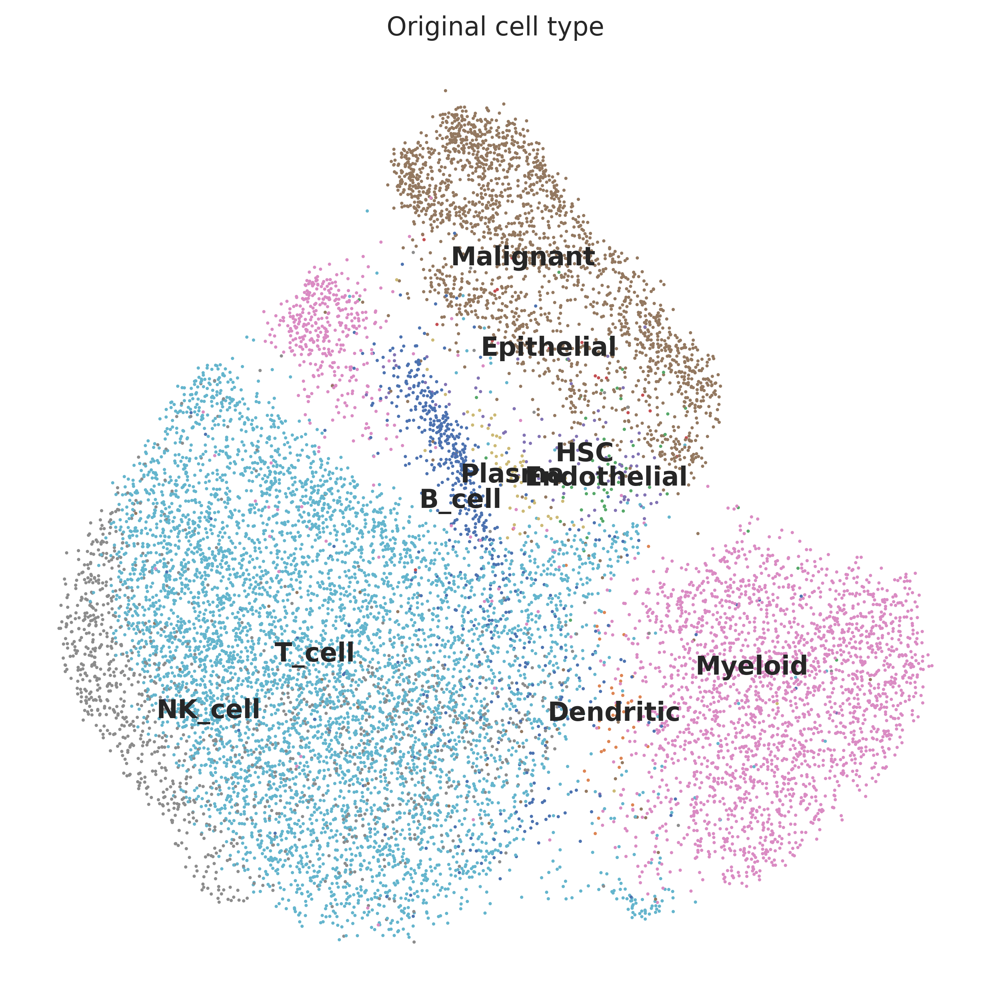

In [89]:
sc.pl.umap(all_dataset, color='cell_type', legend_loc='on data', legend_fontsize='medium', title='Original cell type', frameon=False, save='literature.png')

In [90]:
sorted(list(all_dataset.obs.leiden.unique()))

['B Cells (1)',
 'B Cells (2)',
 'Biliary_LIHC_1',
 'Biliary_LIHC_2',
 'Biliary_LIHC_3',
 'CD4 T',
 'CD4 T / CD8 T',
 'CD8 T (1)',
 'CD8 T (2)',
 'Epithelial Cells (1)',
 'Epithelial Cells (2)',
 'Macrophages (1)',
 'Macrophages (2)',
 'NK']

In [91]:
cell_type_mapping ={
    'B Cells (1)':'B Cells' ,
 'B Cells (2)': 'B Cells',
 'Biliary_LIHC_1': 'nan',
 'Biliary_LIHC_2':'nan' ,
 'Biliary_LIHC_3': 'nan',
 'CD4 T': 'T Cells',
 'CD4 T / CD8 T': 'T Cells',
 'CD8 T (1)':'T Cells' ,
 'CD8 T (2)':'T Cells' ,
 'Epithelial Cells (1)': 'Cancer Cells',
 'Epithelial Cells (2)': 'Cancer Cells',
 'Macrophages (1)': 'Myeloid',
 'Macrophages (2)': 'Myeloid',
 'NK': 'NK'
}

In [92]:
all_dataset.obs['cell_type'].unique()

['Myeloid', 'NK_cell', 'T_cell', 'B_cell', 'Dendritic', 'Malignant', 'Endothelial', 'Plasma', 'HSC', 'Epithelial']
Categories (10, object): ['Myeloid', 'NK_cell', 'T_cell', 'B_cell', ..., 'Endothelial', 'Plasma', 'HSC', 'Epithelial']

In [94]:
cell_type_mapping_original = {
 'Myeloid': 'Myeloid', 
'NK_cell': 'NK' , 
'T_cell': 'T Cells', 
'B_cell': 'B Cells', 
'Dendritic': 'DC', 
'Malignant': 'Cancer Cells', 
'Plasma': 'B Cells', 
'Endothelial': 'Endothelial Cells', 
'HSC': 'HSC', 
'Epithelial': 'Cancer Cells'
}  

In [95]:
all_dataset.obs['cell_type1'] = all_dataset.obs.leiden.map(cell_type_mapping)
all_dataset.obs['original_cell_type'] = all_dataset.obs['cell_type'].map(cell_type_mapping_original)
all_dataset.obs.head(2)

,sample_id,source,disease,cell_type,cell_subtype_clusters,complexity,n_genes,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,batch,leiden,cell_type1,original_cell_type
cell_name,,,,,,,,,,,,,,,
P02_T_0001,P02,Tumor,Relapsed_HCC,Myeloid,C11_Mye.,8167,8167,8159,999451.892470,39794.724970,3.981655,0,Biliary_LIHC_2,nan,Myeloid
P02_T_0002,P02,Tumor,Relapsed_HCC,Myeloid,C11_Mye.,9487,9487,9474,999936.935166,38723.342359,3.872578,0,Macrophages (1),Myeloid,Myeloid


In [96]:
obs_bool = (all_dataset.obs['cell_type1'] == all_dataset.obs['original_cell_type'])|(all_dataset.obs['cell_type1']=='nan')|(all_dataset.obs['original_cell_type']=='nan')
print(sum(obs_bool))
all_dataset = all_dataset[obs_bool, :].copy()

12036


In [97]:
for i, group in all_dataset.obs.groupby(['leiden']):
    n_cell = group.shape[0]
    accuracy = np.sum(group['cell_type1'] == group['original_cell_type']) / n_cell  # annotated same cell type as original cell type
    print(i, round(accuracy, 3), n_cell)

CD4 T 1.0 1561
Macrophages (1) 1.0 1844
CD8 T (1) 1.0 1640
Epithelial Cells (1) 1.0 1433
Biliary_LIHC_1 0.0 1143
CD4 T / CD8 T 1.0 972
Epithelial Cells (2) 1.0 668
NK 1.0 654
Biliary_LIHC_2 0.0 577
Macrophages (2) 1.0 446
B Cells (1) 1.0 464
Biliary_LIHC_3 0.0 357
CD8 T (2) 1.0 211
B Cells (2) 1.0 66


In [98]:
all_dataset.obs['leiden'].value_counts()

Macrophages (1)         1844
CD8 T (1)               1640
CD4 T                   1561
Epithelial Cells (1)    1433
Biliary_LIHC_1          1143
CD4 T / CD8 T            972
Epithelial Cells (2)     668
NK                       654
Biliary_LIHC_2           577
B Cells (1)              464
Macrophages (2)          446
Biliary_LIHC_3           357
CD8 T (2)                211
B Cells (2)               66
Name: leiden, dtype: int64

In [99]:
all_dataset

AnnData object with n_obs × n_vars = 12036 × 17215
    obs: 'sample_id', 'source', 'disease', 'cell_type', 'cell_subtype_clusters', 'complexity', 'n_genes', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'batch', 'leiden', 'cell_type1', 'original_cell_type'
    var: 'n_cells', 'total_counts-1'
    uns: 'leiden', 'neighbors', 'pca', 'sample_id_colors', 'umap', 'rank_genes_groups', 'dendrogram_leiden', 'cell_type_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

/public3/home/scg6055/.conda/envs/py38/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


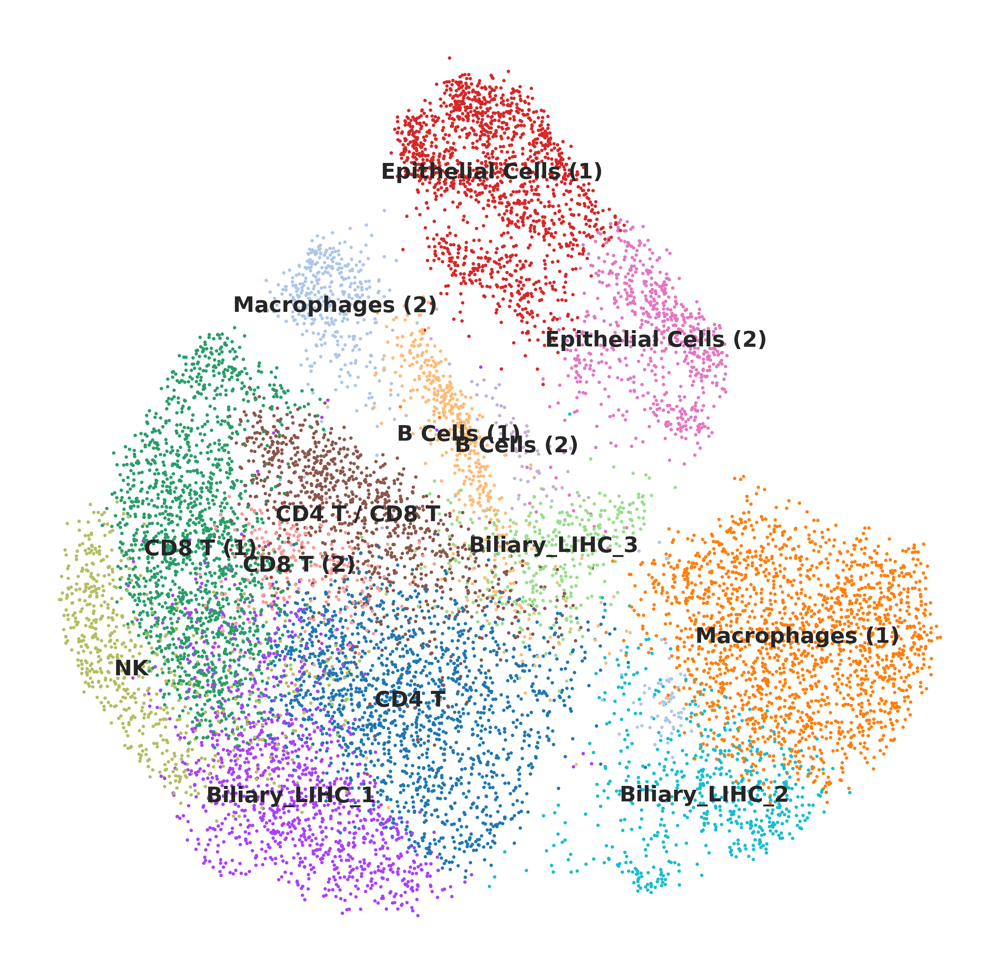

In [100]:
# plt.figure(figsize=(10, 10))
rcParams['figure.figsize'] = 8, 8
sc.pl.umap(all_dataset, color='leiden', legend_loc='on data', legend_fontsize='small', title='', frameon=False, save='_new.png')

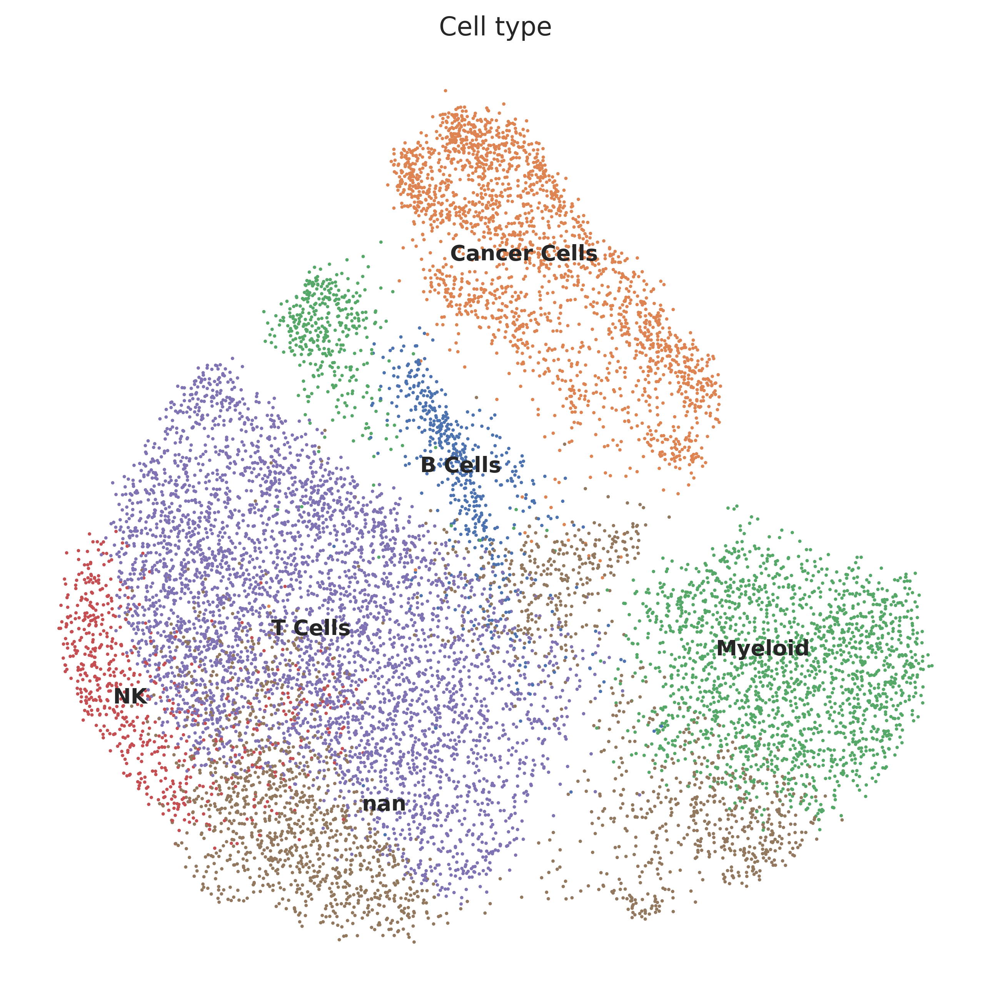

In [101]:
sc.pl.umap(all_dataset, color='cell_type1', legend_loc='on data', legend_fontsize='small', 
           title='Cell type', frameon=False)

In [102]:
all_dataset.write(os.path.join(result_dir, f'{data_set_name}_after_batch_correction.h5ad'))